## **Full Corpus Analysis: Language Models, Clustering, PCA $\rightarrow$ `VOCAB`, `TFIDF`, `DTM` Tables**

In [1]:
# read in docs

import os
from glob import glob
import numpy as np
import pandas as pd

from textparser import TextParser

import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.lancaster import LancasterStemmer

from langmod import NgramCounter
from langmod import NgramLanguageModel
import itertools

import seaborn as sns
import plotly.express as px

from numpy.linalg import norm
from scipy.spatial.distance import pdist
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

from bow_tfidf_pca import create_bow, get_tfidf, get_pca
from prince import PCA
from hac2 import HAC

import requests
from bs4 import BeautifulSoup
import re

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, TfidfTransformer

In [2]:
sns.set()

In [3]:
OHCO = ["book_id", "chap_id", "para_num", "sent_num", "token_num"]

In [4]:
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [5]:
# read in csv files

dickens_LIB = pd.read_csv('dickens_pre_LIB.csv')

dickens_CORPUS = pd.read_csv('dickens_pre_CORPUS.csv')

twain_LIB = pd.read_csv('twain_pre_LIB.csv')

twain_CORPUS = pd.read_csv('twain_pre_CORPUS.csv')

### **`LIB` Table**

In [6]:
# combined LIB
LIB = pd.concat([dickens_LIB, twain_LIB]).set_index(BOOKS).sort_index()

In [7]:
LIB

,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len
book_id,,,,,,,,,
70,Twain/70-what_is_man.txt,what is man,WHAT IS MAN?|THE DEATH OF JEAN|THE TURNING-POI...,twain,non-fiction,1906,1900,17,96111
74,Twain/74-the_adventures_of_tom_sawyer.txt,the adventures of tom sawyer,^\s*CHAPTER\s*[IVXLCM]+$,twain,novel,1876,1870,35,70276
76,Twain/76-the_adventures_of_huckleberry_finn.txt,the adventures of huckleberry finn,^\s*CHAPTER\s*(?:[IVXLCM]+\.|THE LAST)$,twain,novel,1884,1880,43,111908
86,Twain/86-a_connecticut_yankee_in_king_arthurs_...,a connecticut yankee in king arthurs court,^\s*(?:PREFACE|A WORD OF EXPLANATION|THE STRAN...,twain,novel,1889,1880,47,119100
91,Twain/91-tom_sawyer_abroad.txt,tom sawyer abroad,CHAPTER\s[IVXLCM]+\.,twain,novel,1894,1890,13,33969
...,...,...,...,...,...,...,...,...,...
35536,Dickens/35536-the_poems_and_verses_of_charles_...,the poems and verses of charles dickens,THE VILLAGE COQUETTES$|THE LAMPLIGHTER$|SONGS ...,dickens,stories,1885,1880,13,10952
60900,Twain/60900-merry_tales.txt,merry tales,^THE PRIVATE HISTORY OF A CAMPAIGN THAT FAILED...,twain,stories,1892,1890,6,36846
61522,Twain/61522-the_1000000_bank_note.txt,the 1000000 bank note,"^_THE £1,000,000 BANK-NOTE_$|^_METNAL TELEGRAP...",twain,stories,1893,1890,6,65207


### **`CORPUS` Table**

In [8]:
# combined corpus

CORPUS = pd.concat([dickens_CORPUS, twain_CORPUS]).set_index(OHCO) 

# remove NaN values
CORPUS = CORPUS[~CORPUS.term_str.isna()]

In [9]:
CORPUS

pos_tuple  pos  \
book_id chap_id para_num sent_num token_num                               
98      1       0        0        0                  ('The', 'DT')   DT   
                                  1               ('Period', 'NN')   NN   
                1        0        0                  ('It', 'PRP')  PRP   
                                  1                 ('was', 'VBD')  VBD   
                                  2                  ('the', 'DT')   DT   
...                                                            ...  ...   
62739   6       13       0        8           ("Leopold's", 'NNP')  NNP   
                                  9          ('Soliloquy,', 'NNP')  NNP   
                                  10                  ('by', 'IN')   IN   
                                  11               ('Mark', 'NNP')  NNP   
                                  12              ('Twain', 'NNP')  NNP   

                                              token_str   term_str  
book_id chap_id para_num sent_num token_num                         
98      1       0        0        0                 The        the  
                                  1              Period     period  
                1        0        0                  It         it  
                                  1                 was        was  
                                  2                 the        the  
...                                                 ...        ...  
62739   6       13       0        8           Leopold's   leopolds  
                                  9          Soliloquy,  soliloquy  
                                  10                 by         by  
                                  11               Mark       mark  
                                  12              Twain      twain  

[7940320 rows x 4 columns]

### **Recreate DOCs (i.e., group terms into chapters) to create input for `CountVectorizer` (convert docs to token count matrix) and `TfidfTransformer`**

In [10]:
def gather_docs(CORPUS, ohco_level, term_col='term_str'):
    OHCO = CORPUS.index.names
    CORPUS[term_col] = CORPUS[term_col].astype('str')
    DOC = CORPUS.groupby(OHCO[:ohco_level])[term_col].apply(lambda x:' '.join(x)).to_frame('doc_str')
    return DOC

In [11]:
DOC = gather_docs(CORPUS, 2)

In [12]:
DOC

doc_str
book_id chap_id                                                   
70      1        by mark twain samuel langhorne clemens 1835 19...
        2        i a man the machine b personal merit the old m...
        3        the death of jean clemens occurred early in th...
        4        i if i understand the idea the bazar invites s...
        5        these chapters are for children and i shall tr...
...                                                            ...
62739   2        this visit had a more fortunate result than wa...
        3        b h nadal in new york times it is fine one is ...
        4        louise morgan sill in harpers weekly more muti...
        5        the above article which came to hand as the fo...
        6        mr grenfells station is in the lower congo a s...

[2290 rows x 1 columns]

In [13]:
DOC['n_tokens'] = DOC.doc_str.apply(lambda x: len(x.split()))

## **`CountVectorizer` and `TfidfTransformer` method**

### **`DTM` (document term matrix) Table**

In [14]:
ngram_range = (1,4)
n_terms = 15000

In [15]:
count_engine = CountVectorizer(
    stop_words='english',
    ngram_range=ngram_range,
    max_features=n_terms
)

In [16]:
X = count_engine.fit_transform(DOC.doc_str)

In [17]:
# X.toarray()

In [18]:
# count_engine.get_feature_names()

In [19]:
DTM = pd.DataFrame(X.toarray(), 
                   columns=count_engine.get_feature_names_out(), 
                   index=DOC.index)

In [20]:
DTM

10  100  1000  10000  11  12  13  14  15  150  ...  youthful  \
book_id chap_id                                                 ...             
70      1         0    0     0      0   0   0   0   0   0    0  ...         0   
        2         0    0     0      0   0   0   0   0   0    0  ...         0   
        3         0    0     0      0   1   0   0   0   0    0  ...         0   
        4         0    0     0      0   0   0   0   0   0    0  ...         0   
        5         1    0     0      0   2   1   1   1   1    0  ...         0   
...              ..  ...   ...    ...  ..  ..  ..  ..  ..  ...  ...       ...   
62739   2         2    0     0      0   0   0   1   0   2    0  ...         0   
        3         0    0     0      0   0   0   0   0   0    0  ...         0   
        4         0    0     0      0   1   0   0   1   0    0  ...         0   
        5         0    0     0      0   0   0   0   0   0    0  ...         0   
        6         0    0     0      0   0   0   0   0   0    0  ...         0   

                 youths  youve  youve got  yrs  yrs mark  zeal  zealand  \
book_id chap_id                                                           
70      1             0      0          0    0         0     0        0   
        2             0      2          0    0         0     0        0   
        3             0      0          0    0         0     0        0   
        4             0      0          0    0         0     0        0   
        5             0      0          0    0         0     0        0   
...                 ...    ...        ...  ...       ...   ...      ...   
62739   2             0      0          0    0         0     0        0   
        3             0      0          0    0         0     0        0   
        4             0      0          0    0         0     0        0   
        5             0      0          0    0         0     0        0   
        6             0      0          0    0         0     0        0   

                 zealous  zermatt  
book_id chap_id                    
70      1              0        0  
        2              3        0  
        3              0        0  
        4              0        0  
        5              0        0  
...                  ...      ...  
62739   2              0        0  
        3              0        0  
        4              0        0  
        5              0        0  
        6              0        0  

[2290 rows x 15000 columns]

### **Partial `VOCAB` Table (10,000 most common words)**

In [21]:
VOCAB = DTM.sum().to_frame('n')

In [22]:
VOCAB.sort_index()

,n
10,143
100,66
1000,43
10000,53
11,94
...,...
yrs mark,62
zeal,76
zealand,57
zealous,60


In [23]:
VOCAB['n_chars'] = VOCAB.apply(lambda x: len(x.name), 1)
VOCAB['n_tokens'] = VOCAB.apply(lambda x: len(x.name.split()), 1)

In [24]:
VOCAB.value_counts('n_tokens')

n_tokens
1    11654
2     3188
3      148
4       10
dtype: int64

In [25]:
VOCAB[VOCAB.n_tokens == 2]

,n,n_chars,n_tokens
able make,45,9,2
able say,33,8,2
according custom,45,16,2
account having,32,14,2
added mr,82,8,2
...,...,...,...
youre going,76,11,2
youre quite,33,11,2
youre right,84,11,2
youve got,180,9,2


### **`TFIDF` Table**

In [26]:
tfidf_engine = TfidfTransformer(norm='l2', use_idf=True)

In [27]:
X1 = tfidf_engine.fit_transform(DTM)

In [28]:
TFIDF = pd.DataFrame(X1.toarray(), columns=DTM.columns, index=DTM.index)

In [29]:
TFIDF

10  100  1000  10000        11        12        13  \
book_id chap_id                                                             
70      1        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   
        2        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   
        3        0.000000  0.0   0.0    0.0  0.016284  0.000000  0.000000   
        4        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   
        5        0.013390  0.0   0.0    0.0  0.027938  0.013708  0.015315   
...                   ...  ...   ...    ...       ...       ...       ...   
62739   2        0.029635  0.0   0.0    0.0  0.000000  0.000000  0.016948   
        3        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   
        4        0.000000  0.0   0.0    0.0  0.018017  0.000000  0.000000   
        5        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   
        6        0.000000  0.0   0.0    0.0  0.000000  0.000000  0.000000   

                       14        15  150  ...  youthful  youths     youve  \
book_id chap_id                           ...                               
70      1        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   
        2        0.000000  0.000000  0.0  ...       0.0     0.0  0.001236   
        3        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   
        4        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   
        5        0.014983  0.014461  0.0  ...       0.0     0.0  0.000000   
...                   ...       ...  ...  ...       ...     ...       ...   
62739   2        0.000000  0.032005  0.0  ...       0.0     0.0  0.000000   
        3        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   
        4        0.019324  0.000000  0.0  ...       0.0     0.0  0.000000   
        5        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   
        6        0.000000  0.000000  0.0  ...       0.0     0.0  0.000000   

                 youve got  yrs  yrs mark  zeal  zealand   zealous  zermatt  
book_id chap_id                                                              
70      1              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        2              0.0  0.0       0.0   0.0      0.0  0.003099      0.0  
        3              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        4              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        5              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
...                    ...  ...       ...   ...      ...       ...      ...  
62739   2              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        3              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        4              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        5              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  
        6              0.0  0.0       0.0   0.0      0.0  0.000000      0.0  

[2290 rows x 15000 columns]

#### Add `TFIDF` stats to `VOCAB`

In [30]:
VOCAB['tfidf_mean'] = TFIDF.mean()
VOCAB['df'] = DTM[DTM > 0].count()
VOCAB['dfidf'] = VOCAB.df * np.log2(len(TFIDF)/VOCAB.df)

In [31]:
VOCAB.sort_values('dfidf', ascending=False)

,n,n_chars,n_tokens,tfidf_mean,df,dfidf
quiet,1470,5,1,0.005004,842,1215.389497
sound,1453,5,1,0.005273,842,1215.389497
knows,1475,5,1,0.005051,843,1215.389401
pleasant,1415,8,1,0.005137,841,1215.387880
past,1475,4,1,0.005146,844,1215.387594
...,...,...,...,...,...,...
titbulls,36,8,1,0.000331,1,11.161132
ym yes,47,6,2,0.000036,1,11.161132
ym om,36,5,2,0.000028,1,11.161132
ym,400,2,1,0.000308,1,11.161132


### **`BOW` (Bag of Words) Table**

In [32]:
BOW = DTM[DTM > 0].stack().to_frame('n').join(TFIDF[TFIDF > 0].stack().to_frame('tfidf'))

In [33]:
BOW

n     tfidf
book_id chap_id                             
70      1       alphabet       1.0  0.217847
                assassination  1.0  0.220381
                clemens        1.0  0.152058
                concerning     1.0  0.124636
                concerns       1.0  0.195516
...                            ...       ...
62739   6       uncertain      1.0  0.052621
                vast           1.0  0.037823
                went           1.0  0.019335
                went room      1.0  0.070867
                year           1.0  0.029238

[1815944 rows x 2 columns]

In [34]:
DOC['n_tokens_used'] = BOW.groupby(OHCO[:2]).n.sum().astype('int')
DOC['token_use_rate'] = DOC.n_tokens_used / DOC.n_tokens

In [35]:
DOC

doc_str  n_tokens  \
book_id chap_id                                                                
70      1        by mark twain samuel langhorne clemens 1835 19...        71   
        2        i a man the machine b personal merit the old m...     26698   
        3        the death of jean clemens occurred early in th...      4367   
        4        i if i understand the idea the bazar invites s...      3669   
        5        these chapters are for children and i shall tr...      5465   
...                                                            ...       ...   
62739   2        this visit had a more fortunate result than wa...      6390   
        3        b h nadal in new york times it is fine one is ...       686   
        4        louise morgan sill in harpers weekly more muti...      3033   
        5        the above article which came to hand as the fo...      1129   
        6        mr grenfells station is in the lower congo a s...       356   

                 n_tokens_used  token_use_rate  
book_id chap_id                                 
70      1                   40        0.563380  
        2                10213        0.382538  
        3                 1765        0.404168  
        4                 1292        0.352140  
        5                 1996        0.365233  
...                        ...             ...  
62739   2                 2427        0.379812  
        3                  253        0.368805  
        4                 1126        0.371250  
        5                  464        0.410983  
        6                  150        0.421348  

[2290 rows x 4 columns]

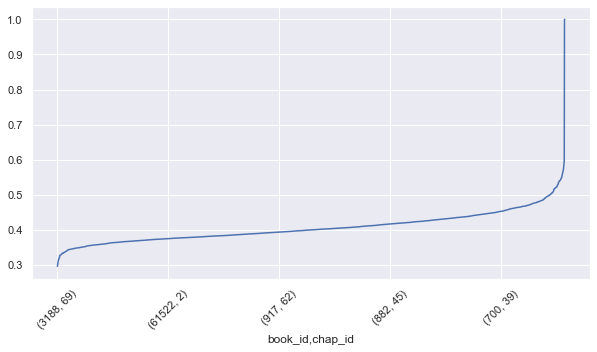

In [36]:
DOC.sort_values('token_use_rate').token_use_rate.plot(rot=45, figsize=(10,5));

In [37]:
LIB['token_use_rate_mean'] = DOC.groupby('book_id').token_use_rate.mean()
LIB['n_tokens'] = DOC.groupby('book_id').n_tokens.sum()

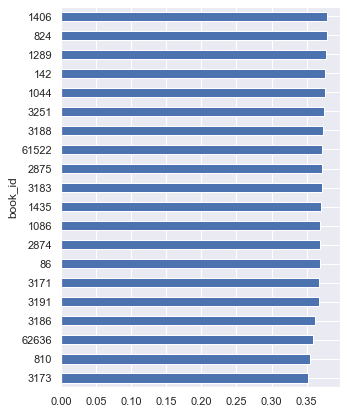

In [38]:
LIB.sort_values('token_use_rate_mean').head(20).token_use_rate_mean.plot.barh(figsize=(5,7));

In [39]:
LIB.sort_values('token_use_rate_mean')[['title', 'author', 'token_use_rate_mean', 'n_tokens']].style.background_gradient()

,title,author,token_use_rate_mean,n_tokens
book_id,,,,
3173,essays on paul bourget,twain,0.351355,11035
810,george silvermans explanation,dickens,0.354244,11065
62636,to the person sitting in darkness,twain,0.359822,4719
3186,the mysterious stranger and other stories,twain,0.362555,41793
3191,goldsmiths friend abroad again,twain,0.367480,6149
3171,in defense of harriet shelley,twain,0.367917,15833
86,a connecticut yankee in king arthurs court,twain,0.369033,119100
2874,personal recollections of joan of arc vol 1,twain,0.369211,77803
1086,a horses tale,twain,0.369696,17085


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


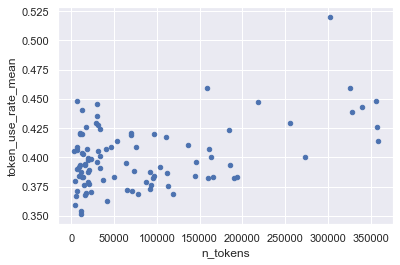

In [40]:
LIB.plot.scatter('n_tokens', 'token_use_rate_mean', logx=False);

## **M03: Language Models**

#### **Create full VOCAB to use for language models**

In [41]:
# df with NLTK's English stopwords
stopwords = pd.DataFrame(nltk.corpus.stopwords.words('english'), columns = ['term_str'])

# make term the index and previous (numeric) index a column
stopwords = stopwords.reset_index().set_index('term_str')

# replace index col with dummy col of 1's
stopwords.columns = ['dummy']
stopwords.dummy = 1

In [42]:
def create_vocab(corpus, i = CORPUS.index.get_level_values(0).unique()):
    
    # subset corpus to include only defined book(s) (default is to include all of them based on unique vals in first level of CORPUS multi-index, i.e., book_id)
    corpus = corpus.loc[i]
    
    # create term table
    vocab = corpus.term_str.value_counts().to_frame('n').sort_index()

    # rename index
    vocab.index.name = 'term_str'

    # number of characters in each term
    vocab['n_chars'] = vocab.index.str.len()

    # probability of term
    vocab['p'] = vocab.n / vocab.n.sum()

    # log2 prob of term
    vocab['i'] = - np.log2(vocab.p)

    # most common POS associated with term
    vocab['max_pos'] = corpus[['term_str', 'pos']].value_counts().unstack(fill_value = 0).idxmax(1)
    
    # term, POS matrix
    TPM = corpus[['term_str', 'pos']].value_counts().unstack()
    
    # col with number of non-NA cells for each row (i.e., along the columns) = num of different POS assigned to each term
    vocab['n_pos'] = TPM.count(axis = 1)
    
    vocab['cat_pos'] = corpus[['term_str', 'pos']].value_counts().to_frame('n').reset_index() \
                   .groupby('term_str').pos.apply(lambda x: set(x))
    
    # map stopwords dummy col to VOCAB df based on shared index
    vocab['stop'] = vocab.index.map(stopwords.dummy)

    # fill non-stopword rows with value 0 in stop col
    vocab['stop'] = vocab['stop'].fillna(0).astype('int')
    
    # Porter stemmer
    stemmer1 = PorterStemmer()
    vocab['stem_porter'] = vocab.apply(lambda x: stemmer1.stem(x.name), 1)

    # Snowball stemmer
    stemmer2 = SnowballStemmer("english")
    vocab['stem_snowball'] = vocab.apply(lambda x: stemmer2.stem(x.name), 1)

    # Lancaster stemmer
    stemmer3 = LancasterStemmer()
    vocab['stem_lancaster'] = vocab.apply(lambda x: stemmer3.stem(x.name), 1)
    
    return vocab

In [43]:
full_VOCAB = create_vocab(CORPUS)

### **Create Training Vocab ($V_{train}$)**

In [44]:
V_TRAIN = sorted(list(set(full_VOCAB.index)))

In [45]:
len(V_TRAIN)

80292

### **Generate Training Sentences**

In [46]:
# convert col type to str otherwise errors when generating training sentences
CORPUS['term_str'] = CORPUS.term_str.astype('str')
CORPUS['token_str'] = CORPUS.term_str.astype('str')

In [47]:
S_TRAIN = list(CORPUS.groupby(OHCO[:-1]).term_str.apply(lambda x: ' '.join(x)).values)

In [48]:
len(S_TRAIN)

393987

### **Generate and Count Ngrams**

In [49]:
train = NgramCounter(S_TRAIN, V_TRAIN)
train.generate()

### **n-gram token table**

In [50]:
train.I

w0     w1     w2
sent_num token_num                         
0        0                <s>    <s>     by
         1                <s>     by   mark
         2                 by   mark  twain
         3               mark  twain   </s>
         4              twain   </s>    <s>
...                       ...    ...    ...
393986   11         soliloquy     by   mark
         12                by   mark  twain
         13              mark  twain   </s>
         14             twain   </s>    NaN
         15              </s>    NaN    NaN

[9122281 rows x 3 columns]

### **Unigram table**

In [51]:
unigram_df = train.LM[0].sort_values('n', ascending = False)
unigram_df

,n,mle
w0,,
<s>,787974,8.637905e-02
the,418963,4.592744e-02
</s>,393987,4.318953e-02
and,310105,3.399424e-02
of,218996,2.400671e-02
...,...,...
jewry,1,1.096217e-07
jewsand,1,1.096217e-07
jewsharp,1,1.096217e-07


### **Bigram table**

In [52]:
bigram_df = train.LM[1].sort_values('n', ascending = False)
bigram_df

n           mle
w0       w1                          
<s>      <s>     393987  4.318953e-02
</s>     <s>     393986  4.318942e-02
of       the      46463  5.093354e-03
<s>      i        38136  4.180534e-03
in       the      36914  4.046576e-03
...                 ...           ...
hindered not          1  1.096217e-07
         it           1  1.096217e-07
         him          1  1.096217e-07
         by           1  1.096217e-07
ěngine   driver       1  1.096217e-07

[1534725 rows x 2 columns]

### **Trigram table**

In [53]:
trigram_df = train.LM[2].sort_values('n', ascending = False)
trigram_df

n           mle
w0     w1     w2                          
</s>   <s>    <s>     393986  4.318943e-02
<s>    <s>    i        38136  4.180534e-03
              the      27928  3.061516e-03
              he       17736  1.944251e-03
              it       16086  1.763375e-03
...                      ...           ...
have   worked like         1  1.096217e-07
              me           1  1.096217e-07
              much         1  1.096217e-07
              myself       1  1.096217e-07
ěngine driver whom         1  1.096217e-07

[4490726 rows x 2 columns]

### **Create language model**

In [54]:
# generate n-gram model using n-gram counter
model = NgramLanguageModel(train)

# implement smoothing (with k = 1) to prevent zero prob. for n-grams unseen in training data
model.k = 1
model.apply_smoothing()

In [55]:
# list of ngram token tables for unigram, bigram, trigram
ngram = model.NG

# list of unigram, bigram, trigram dfs with count, max likelihood estimate (MLE), joint prob, log joint prob, conditional prob, log conditional prob
LM = model.LM

Z1 = model.Z1

Z2 = model.Z2

### **Generate a text with the `.generate_text()` method of the `langmod.NgramLanguageModel` object (`model`)**

In [56]:
model.generate_text()

01. POOR LITTLE MISS IMPUDENCE ONCE MORE FRANK AND SEE HOW HE LIKED BUT HE WAS QUITE CONTENT TO GAZE FOR THESE PURPOSES.

02. DEAR UNFORTUNATE JARBER CAME BACK AND WAS KNOWN.

03. THERE WAS NEVER WORTH THE MONEY INTO HIS PORTERS CHAIR WITH FOLDED HANDS.

04. WHEN HE APPEARED TO BE MARRIED FOR.

05. NOW SAID THE MAN SPEAKING MORE FAMILIARLY AND GOOD FACE ON THE FIRST INSTANCE AND I SHALL HAVE TO BE RESTED BY ADDEDING A DAYS MARCH.

06. WHO WAS COMPETENT AND LASTING FRIENDSHIP.

07. I AM SURE SAID MR QUILP FIRST STARED HER OUT YOURSELF.

08. IT WAS A CASE A BROWN JUG BUT WHETHER TO VENTURE FORTH HE SEES SOMEBODY ELSE AND IVE ALWAYS BEN FRIENDLY TO AMERICA IN SEARCH OF CUSTOMERS WHO WERE SILENTLY WATCHING THE ALLEY WAS FIFTY YEARS OF EXILE AND THAT THEY CLAIM THAT HE THINKS HAS COST YOU NOTHING BUT THE GREAT HILL OVERHANGING THE SEAANYWHEREA YOUNG FISHERMAN TO COME AS I SUPPOSE.

09. SHE HAD BROWN EYES ON ME THAT I COULD SEE THE RESULT.

10. AMEN.

11. THE FAMILY PRACTITIONER FAINTLY BOWI

### **Examining redundancy for unigrams, bigrams, trigrams $\rightarrow$ redundancy increases**

* Entropy equation for n-grams (ng): $H = {\sum}p(ng)log_2(\frac{1}{p(ng)})$, where $p$ is the `.mle` in the unigram, bigram, and trigram tables in the language model
* Redundancy: $R = 1 - \frac{H}{H_{max}}$, where $H$ is the actual model entropy and $H_{max} = \frac{1}{n} * log_2(\frac{1}{n}) * n = log_2(\frac{1}{n})$ is the max entropy

In [57]:
V = len(full_VOCAB)

In [58]:
R = []
for i in range(3):
    N = V**(i+1)
    H = (train.LM[i]['mle'] * np.log2(1/train.LM[i]['mle'])).sum()
    Hmax = np.log2(N)
    R.append(int(round(1 - H/Hmax, 2) * 100))

In [59]:
R

[43, 51, 60]

In [60]:
LM[1].query("w0 != '<UNK>'").query("w1 != '<UNK>'").sort_values('n', ascending = False)

n           mle      mle2         p      log_p
w0       w1                                                         
<s>      <s>     393987  4.318953e-02  0.500000  0.453763  -1.139989
</s>     <s>     393986  4.318942e-02  0.999997  0.830704  -0.267594
of       the      46463  5.093354e-03  0.212164  0.155247  -2.687359
<s>      i        38136  4.180534e-03  0.048398  0.043923  -4.508877
in       the      36914  4.046576e-03  0.265442  0.168285  -2.571021
...                 ...           ...       ...       ...        ...
hindered not          1  1.096217e-07  0.100000  0.000025 -15.293184
         it           1  1.096217e-07  0.100000  0.000025 -15.293184
         him          1  1.096217e-07  0.100000  0.000025 -15.293184
         by           1  1.096217e-07  0.100000  0.000025 -15.293184
ěngine   driver       1  1.096217e-07  1.000000  0.000025 -15.293023

[1534725 rows x 5 columns]

## **M05: Vector Space Models (use reduced `VOCAB` from scikit-learn here again)**

### **Zipf's Law**:

* **Equation**: $f \propto \frac{1}{r} \rightarrow f = \frac{k}{r}$, where $k = fr$
    * f: token frequency
    * r: token rank $\rightarrow$ okens ordered in terms of frequency s.t. rank $r = 1, 2, 3, ..., N$, where $N$ is the number of tokens and the token with rank $r = 1$ is the most frequent token

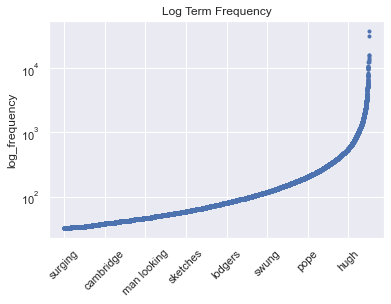

In [61]:
VOCAB.n.sort_values().plot(ylabel = "log_frequency", logy=True, style = '.', rot = 45, title = "Log Term Frequency");

### **Add Term Rank $r$ to `VOCAB`**

In [62]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending = False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1
    VOCAB = VOCAB.set_index('index')

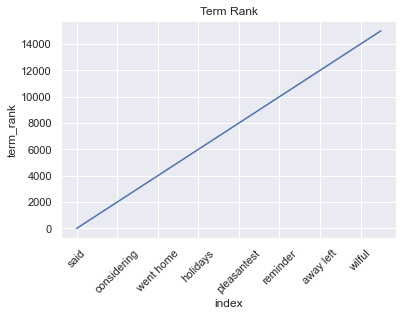

In [63]:
VOCAB.term_rank.plot(ylabel = "term_rank", logx = False, rot = 45, title = "Term Rank");

In [64]:
VOCAB.head()

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf
index,,,,,,,
said,1,38907,4,1,0.062423,2063,310.695592
mr,2,32405,2,1,0.052473,1456,951.259025
time,3,15969,4,1,0.031210,2169,169.870756
little,4,15935,6,1,0.029052,2062,311.987334
man,5,15230,3,1,0.030357,2004,385.700040


### **Alternate Rank: words that appear the same number of times given the same rank**

In [65]:
# times each num of times a term appears (e.g., 18273 terms appear 1 time)
# sort in descending order
# reset indices and rename cols --> nn: times each num of times a term appears

new_rank = VOCAB.n.value_counts()\
                   .sort_index(ascending = False).reset_index().reset_index()\
                   .rename(columns={'level_0': 'term_rank2', 'index': 'n', 'n': 'nn'})\
                    .set_index('n')

VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

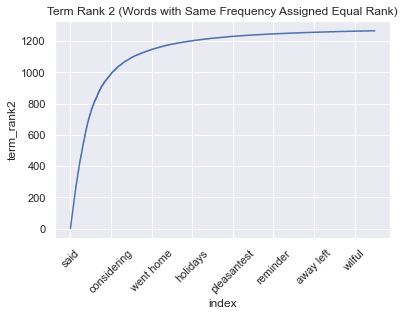

In [66]:
VOCAB.term_rank2.plot(ylabel = 'term_rank2', logx = False, rot = 45, title = "Term Rank 2 (Words with Same Frequency Assigned Equal Rank)");

### **Compute Zipf's $k$ using `term_rank` and `term_rank2`**

* **Equation**: $k = fr$

In [67]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.n * VOCAB.term_rank2

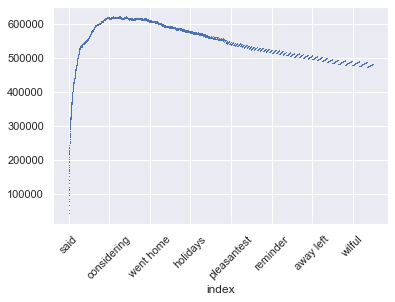

In [68]:
VOCAB.zipf_k.plot(style = ',', rot = 45);

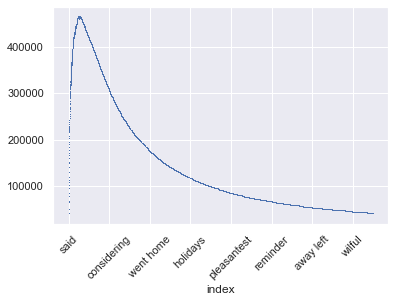

In [69]:
VOCAB.zipf_k2.plot(style = ',', rot = 45);

### **Rank vs. N (frequency `n`)**

As rank (`term_rank2`) increases, frequnecy (`n`) decreases

In [70]:
VOCAB

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf,term_rank2,zipf_k,zipf_k2
index,,,,,,,,,,
said,1,38907,4,1,0.062423,2063,310.695592,1,38907,38907
mr,2,32405,2,1,0.052473,1456,951.259025,2,64810,64810
time,3,15969,4,1,0.031210,2169,169.870756,3,47907,47907
little,4,15935,6,1,0.029052,2062,311.987334,4,63740,63740
man,5,15230,3,1,0.030357,2004,385.700040,5,76150,76150
...,...,...,...,...,...,...,...,...,...,...
wait little,14996,32,11,2,0.000381,29,182.791376,1265,479872,40480
mistrusted,14997,32,10,1,0.000256,30,187.627239,1265,479904,40480
miss charity,14998,32,12,2,0.000137,12,90.914033,1265,479936,40480


### **Inner join full `VOCAB` with scikit-learn `VOCAB` table (to use associated data not provided with `scikit-learn` methods)**

In [71]:
# set terms as index for scikit-learn VOCAB

VOCAB.index.name = 'term_str'

In [72]:
# reduce full VOCAB using one generated from scikit-learn (some discrepancies between scikit-learn and manual methods)
scikit_VOCAB = VOCAB.join(full_VOCAB, how = 'inner', rsuffix = 'full')

scikit_VOCAB

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf,term_rank2,zipf_k,zipf_k2,...,n_charsfull,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,,,,,,,,,,
said,1,38907,4,1,0.062423,2063,310.695592,1,38907,38907,...,4,0.004900,7.673024,VBD,18,"{VB, NN, NNP, VBG, VBZ, VBP, NNS, CC, JJ, VBN,...",0,said,said,said
mr,2,32405,2,1,0.052473,1456,951.259025,2,64810,64810,...,2,0.004081,7.936837,NNP,12,"{VB, NNP, VBZ, VBP, NNS, JJ, POS, MD, VBN, RB,...",0,mr,mr,mr
time,3,15969,4,1,0.031210,2169,169.870756,3,47907,47907,...,4,0.002011,8.957779,NN,16,"{VB, NNP, CD, VBZ, VBP, NNS, CC, JJ, VBN, PDT,...",0,time,time,tim
little,4,15935,6,1,0.029052,2062,311.987334,4,63740,63740,...,6,0.002007,8.960854,JJ,16,"{VB, NNP, CD, VBP, VBZ, NNS, FW, CC, JJ, VBN, ...",0,littl,littl,littl
man,5,15230,3,1,0.030357,2004,385.700040,5,76150,76150,...,3,0.001918,9.026137,NN,19,"{VB, CC, RB, PRP, NN, IN, NNP, VBP, PDT, CD, V...",0,man,man,man
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
graham,14990,32,6,1,0.000222,10,78.392038,1265,479680,40480,...,6,0.000004,17.920766,NNP,1,{NNP},0,graham,graham,graham
syllables,14991,32,9,1,0.000297,29,182.791376,1265,479712,40480,...,9,0.000004,17.920766,NNS,4,"{NN, VBP, NNS, JJ}",0,syllabl,syllabl,syl
moods,14995,32,5,1,0.000391,25,162.931892,1265,479840,40480,...,5,0.000004,17.920766,NNS,5,"{VB, NNP, NNS, NN, FW}",0,mood,mood,mood


In [73]:
# VOCAB.loc[VOCAB['index'].str.contains(' ')]

In [74]:
# scikit_VOCAB[scikit_VOCAB.isna().any(axis=1)]

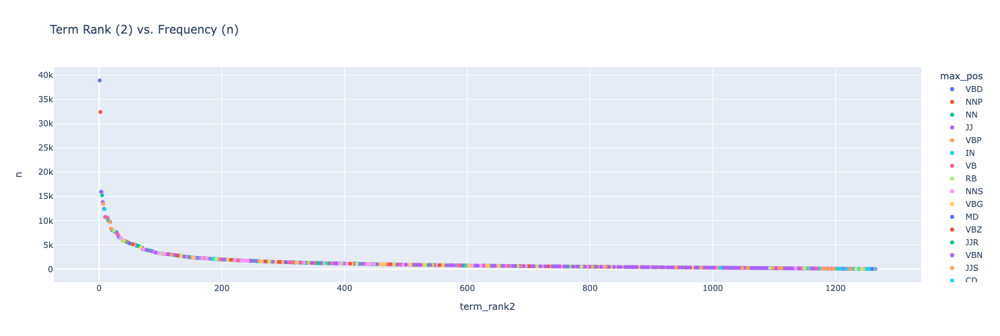

In [75]:
# scatter plot of term_rank2 vs. n color coded by part of speech (POS)

px.scatter(scikit_VOCAB.reset_index(),
           x = 'term_rank2', y = 'n',
           title = 'Term Rank (2) vs. Frequency (n)',
           log_y = False, log_x = False,
           hover_name = 'term_str',
           color = 'max_pos',
           height = 500, width = 800)

### **Reduce number of features in `VOCAB`, TFIDF matrix to the 1000 most significant terms**
* #### DFIDF: the significance measure
* #### Only include terms whose maximum part-of-speech belongs to this set:
    * #### NN NNS VB VBD VBG VBN VBP VBZ JJ JJR JJS RB RBR RBS.
    * #### Note, these are all open categories, excluding proper nouns.

In [76]:
# open POS categories
open_cats = ['NN', 'NNS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ', 'JJ',
             'JJR', 'JJS', 'RB', 'RBR', 'RBS']

# reduce VOCAB to significant terms --> filter POS, sort , take top 1000
SIGS = scikit_VOCAB.loc[scikit_VOCAB.max_pos.isin(open_cats)] \
                        .sort_values('dfidf', ascending = False) \
                        .iloc[:1000,]

In [77]:
SIGS

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf,term_rank2,zipf_k,zipf_k2,...,n_charsfull,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,,,,,,,,,,
quiet,306,1470,5,1,0.005004,842,1215.389497,295,449820,433650,...,5,0.000185,12.399165,JJ,14,"{VB, NNP, VBP, VBZ, NNS, WP, JJ, VBN, RP, RB, ...",0,quiet,quiet,quiet
sound,312,1453,5,1,0.005273,842,1215.389497,300,453336,435900,...,5,0.000183,12.415947,NN,11,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, RB, NN, VBD,...",0,sound,sound,sound
knows,302,1475,5,1,0.005051,843,1215.389401,293,445450,432175,...,5,0.000186,12.394266,VBZ,9,"{VB, NNP, VBZ, VBP, NNS, JJ, VBN, NN, VBD}",0,know,know,know
pleasant,323,1415,8,1,0.005137,841,1215.387880,308,457045,435820,...,8,0.000178,12.454179,JJ,10,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, RB, NN, IN}",0,pleasant,pleasant,pleas
past,303,1475,4,1,0.005146,844,1215.387594,293,446925,432175,...,4,0.000186,12.394266,JJ,13,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, PDT, RB, NN,...",0,past,past,past
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
imagine,1197,484,7,1,0.002781,346,943.370265,815,579348,394460,...,7,0.000061,14.001902,VB,8,"{VB, NNP, VBP, VBZ, JJ, RB, NN, VBD}",0,imagin,imagin,imagin
blind,909,606,5,1,0.003032,346,943.370265,702,550854,425412,...,5,0.000076,13.677592,NN,10,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, RB, NN, IN}",0,blind,blind,blind
tall,1121,511,4,1,0.002614,345,942.084369,789,572831,403179,...,4,0.000064,13.923586,JJ,11,"{VB, NNP, VBZ, VBP, NNS, JJ, VBN, RB, DT, NN, IN}",0,tall,tall,tal


### **"Collapse" the TFIDF matrix so that it contains mean TFIDF of each term by book.**

* #### **Result: matrix with book IDs as rows, significant terms as cols**

In [78]:
TFIDF_sigs = TFIDF[SIGS.index]

In [79]:
TFIDF_sigs

quiet     sound     knows  pleasant      past       red  \
book_id chap_id                                                               
70      1        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        2        0.000438  0.000000  0.002191  0.000877  0.000876  0.000876   
        3        0.000000  0.000000  0.021614  0.000000  0.014401  0.000000   
        4        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        5        0.006184  0.012368  0.000000  0.006188  0.006177  0.043238   
...                   ...       ...       ...       ...       ...       ...   
62739   2        0.006843  0.006843  0.027357  0.000000  0.013670  0.000000   
        3        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        4        0.000000  0.000000  0.000000  0.000000  0.007967  0.000000   
        5        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        6        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   

                  minutes    change     bring   purpose  ...     turns  \
book_id chap_id                                          ...             
70      1        0.000000  0.000000  0.000000  0.000000  ...  0.000000   
        2        0.000875  0.004835  0.001319  0.001747  ...  0.000000   
        3        0.000000  0.007226  0.014461  0.000000  ...  0.000000   
        4        0.000000  0.035633  0.000000  0.000000  ...  0.012819   
        5        0.012346  0.000000  0.006203  0.000000  ...  0.000000   
...                   ...       ...       ...       ...  ...       ...   
62739   2        0.000000  0.000000  0.027455  0.006815  ...  0.000000   
        3        0.000000  0.000000  0.000000  0.000000  ...  0.048013   
        4        0.000000  0.000000  0.008000  0.000000  ...  0.000000   
        5        0.000000  0.000000  0.000000  0.000000  ...  0.000000   
        6        0.000000  0.000000  0.000000  0.000000  ...  0.000000   

                    storm     fault  crying  sympathy   imagine     blind  \
book_id chap_id                                                             
70      1        0.000000  0.000000     0.0  0.000000  0.000000  0.000000   
        2        0.003162  0.000633     0.0  0.000633  0.003799  0.000633   
        3        0.010399  0.000000     0.0  0.020818  0.010409  0.000000   
        4        0.000000  0.000000     0.0  0.000000  0.000000  0.000000   
        5        0.000000  0.000000     0.0  0.000000  0.017858  0.000000   
...                   ...       ...     ...       ...       ...       ...   
62739   2        0.000000  0.009881     0.0  0.009881  0.049404  0.000000   
        3        0.000000  0.048061     0.0  0.000000  0.000000  0.000000   
        4        0.000000  0.000000     0.0  0.011517  0.000000  0.000000   
        5        0.000000  0.000000     0.0  0.000000  0.000000  0.038970   
        6        0.000000  0.000000     0.0  0.000000  0.000000  0.000000   

                     tall      lies      hill  
book_id chap_id                                
70      1        0.000000  0.000000  0.000000  
        2        0.000000  0.001267  0.000000  
        3        0.010419  0.062516  0.000000  
        4        0.000000  0.000000  0.012845  
        5        0.000000  0.000000  0.017876  
...                   ...       ...       ...  
62739   2        0.000000  0.009891  0.000000  
        3        0.000000  0.000000  0.000000  
        4        0.000000  0.023056  0.000000  
        5        0.000000  0.000000  0.000000  
        6        0.000000  0.000000  0.000000  

[2290 rows x 1000 columns]

In [80]:
print('max term TFIDF value:', max(TFIDF_sigs.sum(axis=0)))

print('max TFIDF term:', TFIDF_sigs.sum(axis = 0).idxmax())

max term TFIDF value: 50.427033814307045
max TFIDF term: sir


In [81]:
print('Max total TFIDF value by book and chapter:', max(TFIDF_sigs.sum(axis=1)))

print('(Book_id, chap_id) with max total TFIDF: ', TFIDF_sigs.sum(axis = 1).idxmax())

print('Title of book with max total TFIDF:', LIB.loc[TFIDF_sigs.sum(axis = 1).idxmax()[0]].title.title())

Max total TFIDF value by book and chapter: 11.699701378835233
(Book_id, chap_id) with max total TFIDF:  (675, 3)
Title of book with max total TFIDF: American Notes


### **Rank and TFIDF Mean**

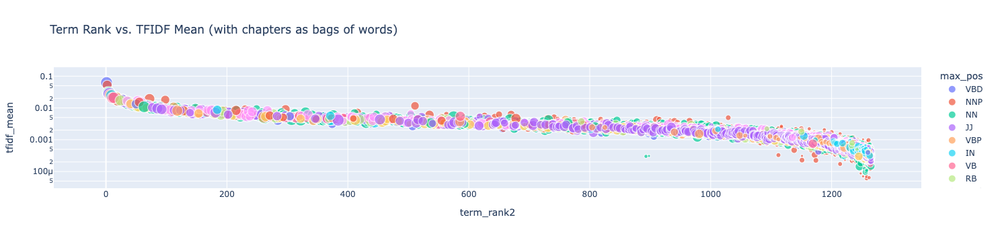

In [82]:
px.scatter(scikit_VOCAB.reset_index(),
           x = 'term_rank2', y = 'tfidf_mean',
           title = 'Term Rank vs. TFIDF Mean (with chapters as bags of words)',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'],
           log_y = True, log_x = False)

### **Rank and DFIDF**

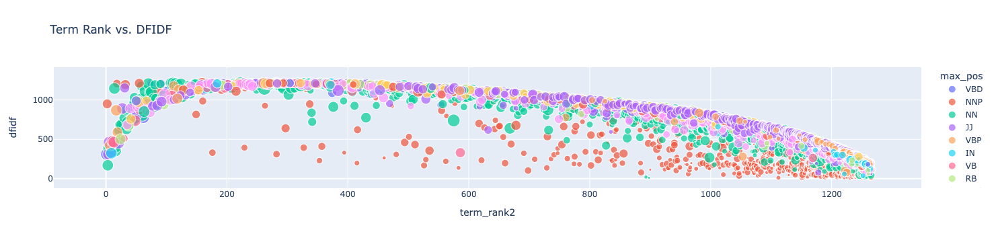

In [83]:
px.scatter(scikit_VOCAB.reset_index(),
           x = 'term_rank2', y = 'dfidf',
           title = 'Term Rank vs. DFIDF',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'])

## **M06: Similarity and Clustering**

### **Collapse Bags (to use for clustering)**

* #### Note: not the same as computing TFIDF with larger bags

#### **Mean TFIDF for each book for all terms**

In [84]:
# group by book_id (BOOKS = OHCO[:1])
mean_TFIDF = TFIDF.groupby(BOOKS).mean()

mean_TFIDF

,10,100,1000,10000,11,12,13,14,15,150,...,youthful,youths,youve,youve got,yrs,yrs mark,zeal,zealand,zealous,zermatt
book_id,,,,,,,,,,,,,,,,,,,,,
70,0.003263,0.000000,0.000000,0.000000,0.003165,0.002141,0.000901,0.001183,0.001142,0.000000,...,0.000235,0.000000,0.002154,0.001523,0.0,0.0,0.002953,0.001729,0.000182,0.0
74,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000925,0.000000,0.008501,0.001661,0.0,0.0,0.000429,0.000000,0.000000,0.0
76,0.000604,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.010988,0.002435,0.0,0.0,0.000000,0.000000,0.000000,0.0
86,0.000985,0.001973,0.000000,0.000842,0.000000,0.001296,0.000000,0.000431,0.000413,0.000871,...,0.000000,0.000000,0.003178,0.001089,0.0,0.0,0.003246,0.000000,0.000000,0.0
91,0.001945,0.000000,0.000000,0.000000,0.002662,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.009624,0.008349,0.0,0.0,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35536,0.010013,0.000000,0.000000,0.000000,0.006234,0.004133,0.000000,0.000000,0.000000,0.000000,...,0.001202,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0
60900,0.000504,0.006978,0.001257,0.000000,0.000525,0.000516,0.000576,0.000564,0.004250,0.000617,...,0.002085,0.009625,0.004576,0.001507,0.0,0.0,0.000000,0.000000,0.000000,0.0
61522,0.001825,0.000000,0.000000,0.000000,0.005318,0.000000,0.000000,0.004085,0.000000,0.002236,...,0.001189,0.002017,0.007963,0.002345,0.0,0.0,0.000000,0.000000,0.000000,0.0


#### **Mean TFIDF for all book for 1000 most significant terms only**

In [85]:
mean_TFIDF_sigs = TFIDF_sigs.groupby(BOOKS).mean()

mean_TFIDF_sigs

,quiet,sound,knows,pleasant,past,red,minutes,change,bring,purpose,...,turns,storm,fault,crying,sympathy,imagine,blind,tall,lies,hill
book_id,,,,,,,,,,,,,,,,,,,,,
70,0.002005,0.008424,0.004801,0.003517,0.007147,0.007458,0.005749,0.008450,0.006280,0.000103,...,0.001623,0.002062,0.001215,0.002428,0.002439,0.003332,0.000855,0.001590,0.005988,0.002348
74,0.004761,0.009800,0.002170,0.001511,0.002695,0.006722,0.005410,0.002260,0.001926,0.001323,...,0.001859,0.003865,0.002066,0.006095,0.002970,0.000531,0.000578,0.002067,0.000000,0.013508
76,0.004695,0.009087,0.003619,0.000685,0.002830,0.002783,0.005504,0.002982,0.002366,0.000351,...,0.006231,0.002760,0.005321,0.006844,0.001235,0.000492,0.001222,0.002024,0.002990,0.003412
86,0.004167,0.010259,0.001805,0.004563,0.004141,0.004074,0.005601,0.009984,0.008830,0.003350,...,0.001450,0.007544,0.002744,0.002229,0.001184,0.007110,0.000565,0.001739,0.002577,0.002469
91,0.007928,0.007386,0.018639,0.001179,0.009024,0.005655,0.007730,0.002181,0.000000,0.000679,...,0.000883,0.010887,0.003971,0.003986,0.000000,0.001309,0.008611,0.004792,0.003185,0.014796
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35536,0.004995,0.004029,0.003845,0.004080,0.009533,0.000000,0.000000,0.006873,0.003030,0.010947,...,0.001288,0.006690,0.000000,0.000000,0.000000,0.000000,0.000000,0.001290,0.008508,0.000000
60900,0.003477,0.015039,0.009827,0.005442,0.004267,0.007637,0.008937,0.005761,0.006301,0.000232,...,0.007384,0.031917,0.001595,0.001144,0.000336,0.005863,0.002624,0.001597,0.001933,0.014940
61522,0.003361,0.006157,0.005775,0.002733,0.012386,0.005356,0.012778,0.015535,0.007057,0.003085,...,0.001108,0.014495,0.007599,0.000455,0.000455,0.003763,0.003509,0.001565,0.004276,0.003130


### **`DOC` Table**

* #### Same as `LIB` table when books are docs

In [86]:
book_DOC = pd.DataFrame(index = mean_TFIDF.index)

In [87]:
book_DOC = book_DOC.join(LIB[['author', 'title']])

book_DOC['label'] = book_DOC.apply(lambda x: f"{x.author.split(',')[0]} {x.name}: {x.title}", 1)

In [88]:
book_DOC

,author,title,label
book_id,,,
70,twain,what is man,twain 70: what is man
74,twain,the adventures of tom sawyer,twain 74: the adventures of tom sawyer
76,twain,the adventures of huckleberry finn,twain 76: the adventures of huckleberry finn
86,twain,a connecticut yankee in king arthurs court,twain 86: a connecticut yankee in king arthurs...
91,twain,tom sawyer abroad,twain 91: tom sawyer abroad
...,...,...,...
35536,dickens,the poems and verses of charles dickens,dickens 35536: the poems and verses of charles...
60900,twain,merry tales,twain 60900: merry tales
61522,twain,the 1000000 bank note,twain 61522: the 1000000 bank note


### **Normalized Tables for Clustering**

In [89]:
# binary table
L0 = mean_TFIDF_sigs.astype('bool').astype('int')

# Manhattan distance (L1 norm): divide each value by sum down cols
L1 = mean_TFIDF_sigs.apply(lambda x: x / x.sum(), 1)

# Euclidean distance (L2 norm)
L2 = mean_TFIDF_sigs.apply(lambda x: x / norm(x), 1) # Euclidean

In [90]:
assert round(L1.sum(1).sum()) == len(mean_TFIDF_sigs)

In [91]:
assert round(((L2.T)**2).sum().sum()) == len(mean_TFIDF_sigs)

### **Create table of book pairs (doc pair table `PAIRS`)**

In [92]:
mean_TFIDF_sigs.T.corr().stack()

book_id  book_id
70       70         1.000000
         74         0.250449
         76         0.122805
         86         0.371353
         91         0.141872
                      ...   
62739    35536      0.077672
         60900      0.107768
         61522      0.145973
         62636      0.141820
         62739      1.000000
Length: 9025, dtype: float64

In [93]:
# correlation between books --> stack and convert to df with col for  raw correlation vals
PAIRS = 1 - mean_TFIDF_sigs.T.corr().stack().to_frame('corr_raw')

# rename indices
PAIRS.index.names = ['doc_a', 'doc_b']

# remove identities (e.g., corr(105, 105) and reverse dupliciates (e.g., corr(105, 121) = corr(121, 105))
PAIRS = PAIRS.query("doc_a > doc_b")

In [94]:
PAIRS

corr_raw
doc_a doc_b          
74    70     0.749551
76    70     0.877195
      74     0.561570
86    70     0.628647
      74     0.666476
...               ...
62739 33077  0.737689
      35536  0.922328
      60900  0.892232
      61522  0.854027
      62636  0.858180

[4465 rows x 1 columns]

#### **Compute distance measures between all pairs of books using `pdist()`**

In [95]:
combos  = [
    (mean_TFIDF_sigs, 'cityblock', 'cityblock–raw'),
    (mean_TFIDF_sigs, 'euclidean', 'euclidean–raw'),
    (L2, 'euclidean', 'euclidean–l2'),    
    (mean_TFIDF_sigs, 'cosine', 'cosine–raw'),
    (L1, 'cityblock', 'cityblock–l1'),
    (L0, 'jaccard', 'jaccard–l0'),
    (L0, 'jensenshannon', 'js–l0'),
    (L1, 'jensenshannon', 'js–l1'),
    (L2, 'jensenshannon', 'js–l2'),
]

In [96]:
for X, metric, label in combos:
    PAIRS[label] = pdist(X, metric)

#### **Compare Distributions**

In [97]:
PAIRS.head(20)

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
74    70     0.749551       3.443892       0.174760      0.877862    0.385321   
76    70     0.877195       4.325724       0.274651      1.080125    0.583335   
      74     0.561570       3.041906       0.156718      0.747013    0.279014   
86    70     0.628647       4.424334       0.268799      1.074764    0.577559   
      74     0.666476       4.835658       0.295649      1.120307    0.627544   
      76     0.751092       3.326198       0.153771      0.845949    0.357815   
91    70     0.858128       3.028911       0.154427      0.836753    0.350077   
      74     0.564321       2.807161       0.127840      0.669822    0.224331   
      76     0.164675       2.732404       0.129534      0.673188    0.226591   
      86     0.728610       2.705490       0.171409      0.828755    0.343418   
93    70     0.902214       3.242819       0.154110      0.881665    0.388667   
      74     0.608653       3.502017       0.180617      1.024359    0.524656   
      76     0.125348       5.110830       0.229741      0.899404    0.404463   
      86     0.750698       4.791522       0.235079      1.003791    0.503798   
      91     0.200823       5.548531       0.273882      0.903205    0.407889   
98    70     0.841852       4.338235       0.210935      0.968993    0.469474   
      74     0.871615       5.387368       0.245456      0.828468    0.343180   
      76     0.960148       4.261791       0.225493      1.017747    0.517905   
      86     0.745776       3.564010       0.173712      0.913350    0.417104   
      91     0.991261       3.637280       0.183833      0.918225    0.421569   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
74    70         0.784942    0.064581  0.152015  0.357674  0.357674  
76    70         0.985708    0.195939  0.271777  0.449235  0.449235  
      74         0.608889    0.039275  0.117815  0.287296  0.287296  
86    70         1.027798    0.313265  0.352104  0.467088  0.467088  
      74         1.124799    0.389399  0.399797  0.507979  0.507979  
      76         0.766244    0.035000  0.110952  0.349687  0.349687  
91    70         0.717898    0.078868  0.168468  0.334341  0.334341  
      74         0.589954    0.028084  0.099163  0.271690  0.271690  
      76         0.596223    0.042296  0.122367  0.276767  0.276767  
      86         0.595302    0.033099  0.107881  0.277720  0.277720  
93    70         0.788588    0.036072  0.112727  0.359550  0.359550  
      74         0.849319    0.031000  0.104239  0.380618  0.380618  
      76         0.842664    0.073000  0.162025  0.381648  0.381648  
      86         0.975518    0.159478  0.243933  0.438085  0.438085  
      91         0.856137    0.066265  0.154096  0.380125  0.380125  
98    70         0.917405    0.140281  0.227894  0.420501  0.420501  
      74         0.752227    0.038000  0.115743  0.336887  0.336887  
      76         0.913935    0.133534  0.221960  0.421361  0.421361  
      86         0.853126    0.057172  0.142819  0.383235  0.383235  
      91         0.780895    0.032000  0.105955  0.357681  0.357681

### **Hierarchical agglomerative cluster diagrams for the distance measures**

In [98]:
LIB['label'] = book_DOC['label']

In [99]:
def hca(sims, title="My Dendrogram", linkage_method='weighted', color_thresh=None, figsize=(20, 30)):
    
    # calculate linkage using given method   
    tree = sch.linkage(sims, method=linkage_method)
    
    # extract labels (title, year)
    labels = LIB.label.values
    
    # set color threshold
    if not color_thresh:
        color_thresh = pd.DataFrame(tree)[2].median()
    
    # plot dendrograms for each distance metric and linkage method
    plt.figure()
    fig, axes = plt.subplots(figsize=figsize)
    dendrogram = sch.dendrogram(tree, 
                                labels=labels, 
                                orientation="left", 
                                count_sort=True,
                                distance_sort=True,
                                above_threshold_color='.75',
                                color_threshold=color_thresh
                               )
    plt.tick_params(axis='both', which='major', labelsize=14)
    fig.suptitle(title, fontsize=20)

<Figure size 432x288 with 0 Axes>

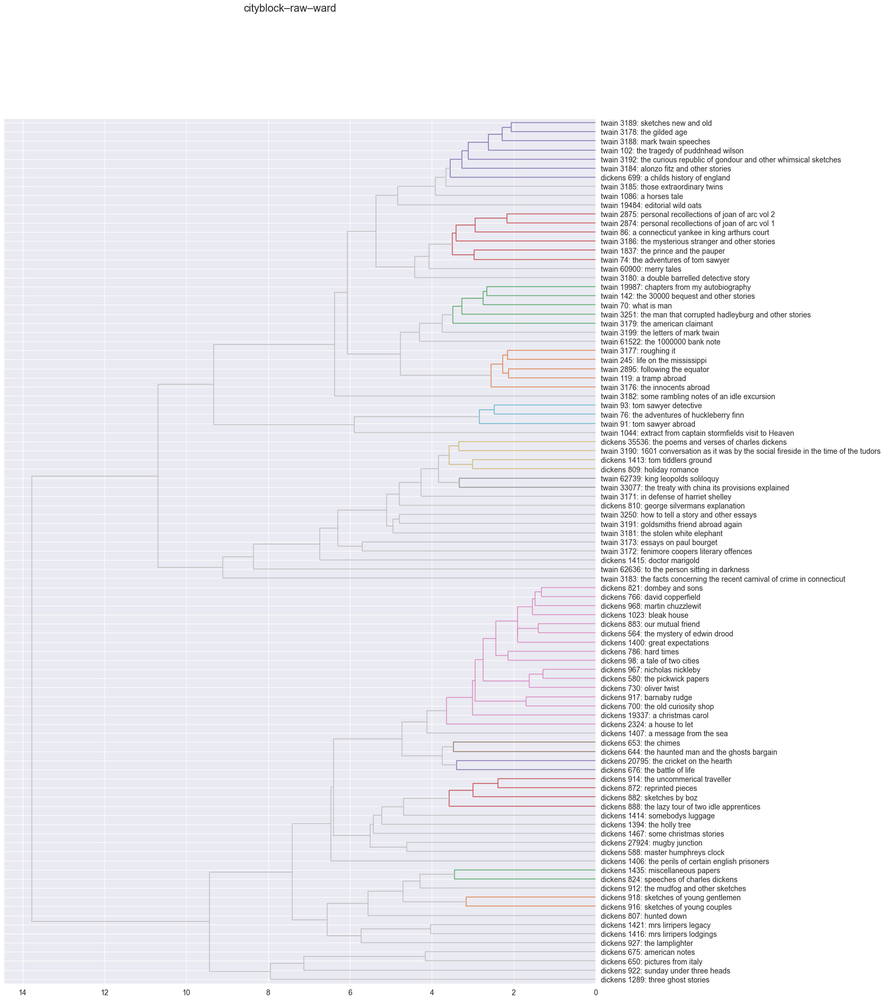

<Figure size 432x288 with 0 Axes>

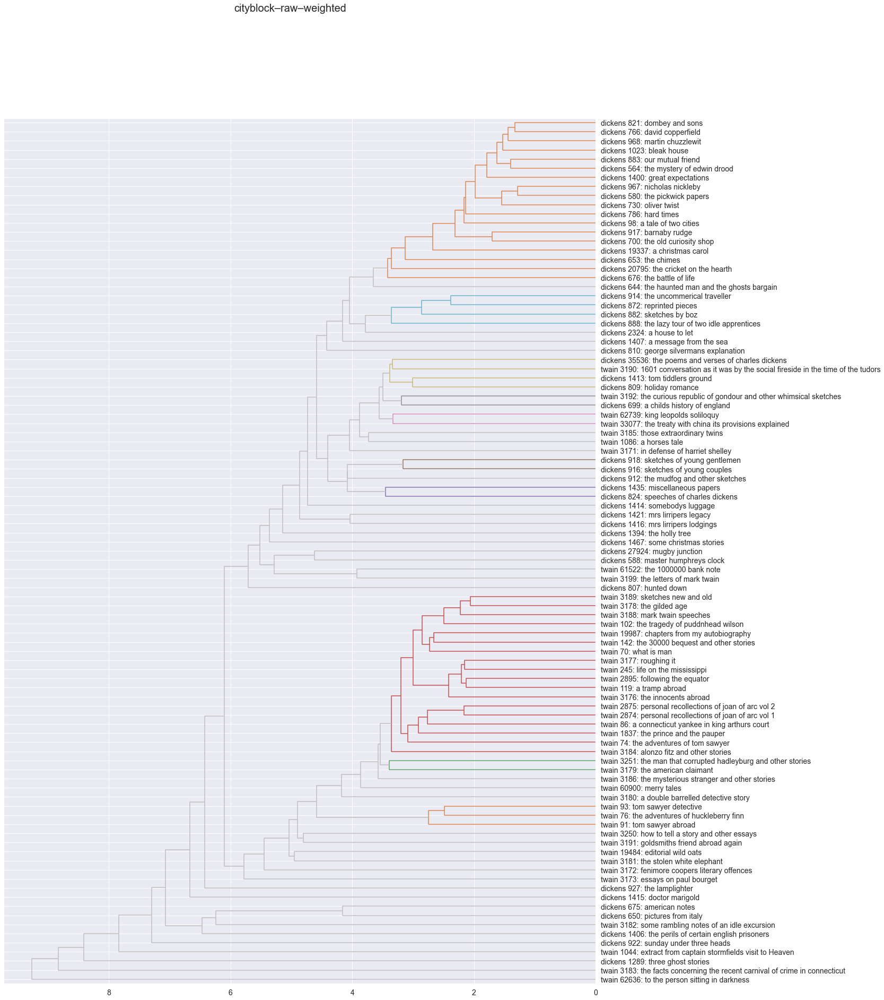

<Figure size 432x288 with 0 Axes>

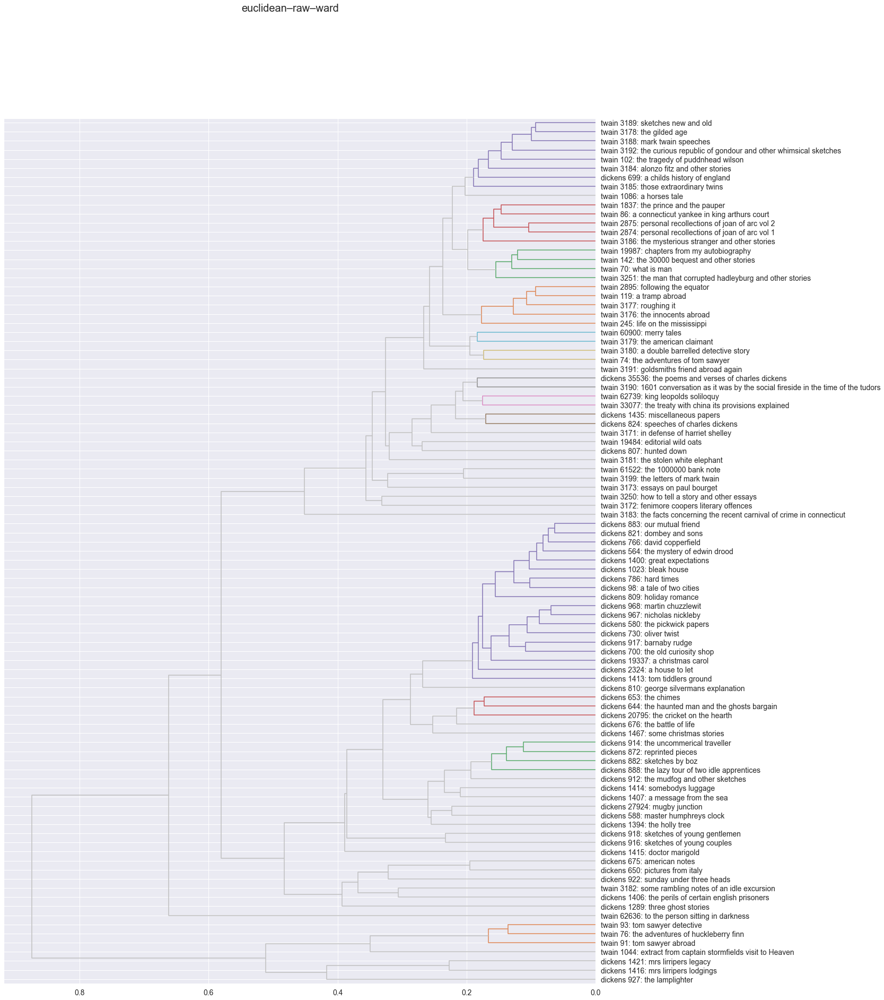

<Figure size 432x288 with 0 Axes>

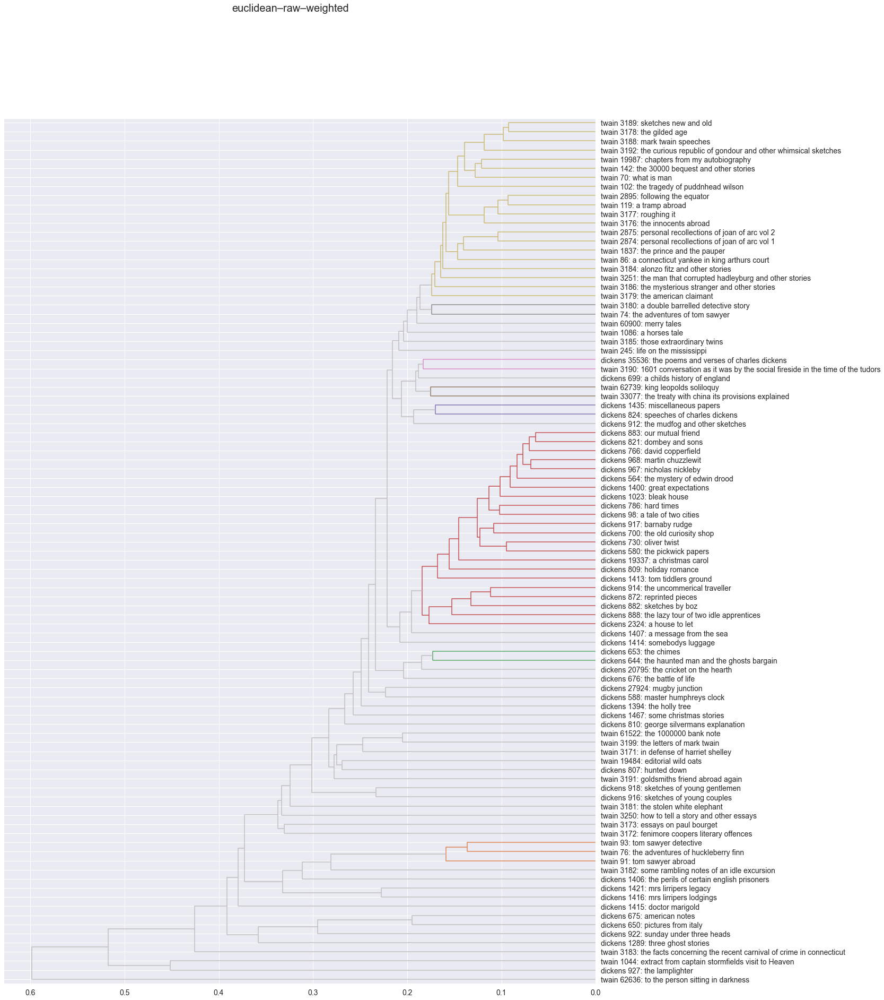

In [100]:
for combo in combos[:2]:
    # column in df (i.e., distance metric)
    m = combo[-1]
    
    # two lnikage methods
    for l in ['ward','weighted']:
        # title: distance metric - linkage method
        title = f"{m}–{l}"
        hca(PAIRS[m], title, linkage_method=l)

### **Top 20 nouns by DFIDF, sorted in descending order (including plural nouns but not proper nouns)**

In [101]:
# noun taglist (excluding proper nouns)
noun_tags = ['NN', 'NNS']

SIGS.loc[SIGS.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20)

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf,term_rank2,zipf_k,zipf_k2,...,n_charsfull,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,,,,,,,,,,
sound,312,1453,5,1,0.005273,842,1215.389497,300,453336,435900,...,5,0.000183,12.415947,NN,11,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, RB, NN, VBD,...",0,sound,sound,sound
minutes,292,1510,7,1,0.005475,845,1215.384077,283,440920,427330,...,7,0.000190,12.360433,NNS,10,"{NNP, CD, VBP, VBZ, NNS, JJ, NN, FW, VBD, IN}",0,minut,minut,minut
change,301,1480,6,1,0.005309,838,1215.372727,292,445480,432160,...,6,0.000186,12.389384,NN,11,"{VB, NNP, VBP, VBZ, NNS, CC, JJ, JJR, NN, VBD,...",0,chang,chang,chang
purpose,326,1409,7,1,0.004688,849,1215.352957,311,459334,438199,...,7,0.000177,12.460310,NN,9,"{VB, NNP, VBP, VBZ, NNS, JJ, RB, NN, VBD}",0,purpos,purpos,purpos
character,298,1495,9,1,0.005373,831,1215.277017,289,445510,432055,...,9,0.000188,12.374836,NN,11,"{VB, NNP, VBZ, VBP, NNS, JJ, VBN, RB, JJR, NN,...",0,charact,charact,charact
father,108,3097,6,1,0.009764,855,1215.255339,107,334476,331379,...,6,0.000390,11.324110,NN,15,"{VB, NNP, VBP, VBZ, NNS, CC, JJ, PRP$, RB, PRP...",0,father,father,fath
foot,322,1415,4,1,0.005108,856,1215.233151,308,455630,435820,...,4,0.000178,12.454179,NN,12,"{VB, NNP, VBP, VBZ, NNS, JJ, VBN, PDT, RB, NN,...",0,foot,foot,foot
attention,368,1277,9,1,0.004464,823,1215.063425,346,469936,441842,...,9,0.000161,12.602223,NN,11,"{VB, NNP, VBZ, VBP, NNS, JJ, RP, RB, NN, VBD, IN}",0,attent,attent,at
mother,112,3070,6,1,0.009620,863,1215.030760,111,343840,340770,...,6,0.000387,11.336743,NN,18,"{VB, NNP, CD, VBZ, VBP, NNS, FW, CC, JJ, PRP$,...",0,mother,mother,moth


In [102]:
top_20_nouns = list(scikit_VOCAB.loc[scikit_VOCAB.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20).index)

In [103]:
print(top_20_nouns)

['sound', 'minutes', 'change', 'purpose', 'character', 'father', 'foot', 'attention', 'mother', 'arm', 'order', 'feeling', 'silence', 'anybody', 'chair', 'forth', 'corner', 'truth', 'theres', 'book']


### **Most "Significant" Book based on mean TFIDF**

In [104]:
BOW.groupby(BOOKS).mean().sort_values('tfidf', ascending = False).join(LIB, on = 'book_id')

,n,tfidf,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len,token_use_rate_mean,n_tokens,label
book_id,,,,,,,,,,,,,,
3191,1.310267,0.051287,Twain/3191-goldsmiths_friend_abroad_again.txt,goldsmiths friend abroad again,LETTER\s[IVXLCM]+,twain,stories,1870,1870,7,6149,0.367480,6149,twain 3191: goldsmiths friend abroad again
3188,1.434488,0.050597,Twain/3188-mark_twain_speeches.txt,mark twain speeches,INTRODUCTION$|PREFACE$|THE STORY OF A SPEECH$|...,twain,non-fiction,1880,1880,105,92256,0.373105,92256,twain 3188: mark twain speeches
35536,1.442284,0.045688,Dickens/35536-the_poems_and_verses_of_charles_...,the poems and verses of charles dickens,THE VILLAGE COQUETTES$|THE LAMPLIGHTER$|SONGS ...,dickens,stories,1885,1880,13,10952,0.421018,10952,dickens 35536: the poems and verses of charles...
1086,1.464964,0.042809,Twain/1086-a_horses_tale.txt,a horses tale,^[IVXLCM]+$,twain,novel,1907,1900,15,17085,0.369696,17085,twain 1086: a horses tale
810,1.447674,0.041516,Dickens/810-george_silvermans_explanation.txt,george silvermans explanation,[A-Z]+\sCHAPTER$,dickens,stories,1868,1860,9,11065,0.354244,11065,dickens 810: george silvermans explanation
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19337,1.931442,0.011028,Dickens/19337-a_christmas_carol.txt,a christmas carol,^\s*STAVE\s[A-Z]+$,dickens,novel,1843,1840,5,28828,0.429220,28828,dickens 19337: a christmas carol
653,2.117154,0.010854,Dickens/653-the_chimes.txt,the chimes,^CHAPTER\s[IVXLCM]+,dickens,novel,1844,1840,4,30742,0.435247,30742,dickens 653: the chimes
644,2.384091,0.009655,Dickens/644-the_haunted_man_and_the_ghosts_bar...,the haunted man and the ghosts bargain,^CHAPTER\s[IVXLCM]+$,dickens,stories,1848,1840,3,33904,0.423946,33904,dickens 644: the haunted man and the ghosts ba...


### **Compare Distributions**

In [105]:
# merge PAIRS, LIB to add label col twice (for doc_a, doc_b) to include author, book_id, title

DISTS = pd.merge(PAIRS.reset_index(), LIB['label'], left_on = 'doc_a', right_on = 'book_id', how = 'left')
                                                                                                                                                                                                                                                      
DISTS = pd.merge(DISTS, LIB['label'], left_on = 'doc_b', right_on = 'book_id', how = 'right')

DISTS = DISTS.set_index(['doc_a', 'doc_b']).rename({'label_x': 'label_a', 'label_y': 'label_b'}, axis = 1)

In [106]:
# reorder df columns so that label_a and label_b first

DISTS.insert(loc = 0, column = 'label_a', value = DISTS.pop('label_a'))

DISTS.insert(loc = 1, column = 'label_b', value = DISTS.pop('label_b'))

In [107]:
DISTS.head(20).style.background_gradient(cmap='YlGnBu', high=.5, axis=0)

,,label_a,label_b,corr_raw,cityblock–raw,euclidean–raw,euclidean–l2,cosine–raw,cityblock–l1,jaccard–l0,js–l0,js–l1,js–l2
doc_a,doc_b,,,,,,,,,,,,
74.0,70.0,twain 74: the adventures of tom sawyer,twain 70: what is man,0.749551,3.443892,0.174760,0.877862,0.385321,0.784942,0.064581,0.152015,0.357674,0.357674
76.0,70.0,twain 76: the adventures of huckleberry finn,twain 70: what is man,0.877195,4.325724,0.274651,1.080125,0.583335,0.985708,0.195939,0.271777,0.449235,0.449235
86.0,70.0,twain 86: a connecticut yankee in king arthurs court,twain 70: what is man,0.628647,4.424334,0.268799,1.074764,0.577559,1.027798,0.313265,0.352104,0.467088,0.467088
91.0,70.0,twain 91: tom sawyer abroad,twain 70: what is man,0.858128,3.028911,0.154427,0.836753,0.350077,0.717898,0.078868,0.168468,0.334341,0.334341
93.0,70.0,twain 93: tom sawyer detective,twain 70: what is man,0.902214,3.242819,0.154110,0.881665,0.388667,0.788588,0.036072,0.112727,0.359550,0.359550
98.0,70.0,dickens 98: a tale of two cities,twain 70: what is man,0.841852,4.338235,0.210935,0.968993,0.469474,0.917405,0.140281,0.227894,0.420501,0.420501
102.0,70.0,twain 102: the tragedy of puddnhead wilson,twain 70: what is man,0.719396,3.377338,0.155772,0.858345,0.368378,0.773822,0.031000,0.104239,0.345496,0.345496
119.0,70.0,twain 119: a tramp abroad,twain 70: what is man,0.571939,3.462101,0.162765,0.803354,0.322689,0.706653,0.032096,0.106192,0.324848,0.324848
142.0,70.0,twain 142: the 30000 bequest and other stories,twain 70: what is man,0.521306,4.227106,0.295613,1.164128,0.677597,0.985952,0.244444,0.307076,0.462445,0.462445


### **Compare Z normalized distributions**

In [108]:
ZPAIRS = (PAIRS - PAIRS.mean()) / PAIRS.std()

In [109]:
ZPAIRS

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
74    70    -0.458069      -0.890432      -0.841634     -0.644489   -0.713730   
76    70     0.441934      -0.206272       0.306032      0.654543    0.629107   
      74    -1.783497      -1.202308      -1.048924     -1.484864   -1.434649   
86    70    -1.310551      -0.129767       0.238802      0.620114    0.589938   
      74    -1.043820       0.189354       0.547279      0.912610    0.928909   
...               ...            ...            ...           ...         ...   
62739 33077 -0.541709       2.294787       2.731523      1.208192    1.285745   
      35536  0.760164       0.075753      -0.209170      0.521224    0.478517   
      60900  0.547957       2.784314       2.742117      1.070395    1.117604   
      61522  0.278579       0.817365       0.017435      0.159054    0.084181   
      62636  0.307864       1.202207       2.669188      1.288084    1.384659   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
74    70        -0.794386   -1.167298 -1.127952 -0.861693 -0.861693  
76    70         0.060883   -0.540212 -0.373386  0.019135  0.019135  
      74        -1.544376   -1.288107 -1.343437 -1.538737 -1.538737  
86    70         0.240186    0.019890  0.132720  0.190880  0.190880  
      74         0.653412    0.383341  0.433209  0.584257  0.584257  
...                   ...         ...       ...       ...       ...  
62739 33077      1.655655    1.844225  1.605882  1.556336  1.556336  
      35536      0.507085    0.550611  0.586267  0.573511  0.573511  
      60900      1.513333    1.816386  1.560353  1.407345  1.407345  
      61522      0.313551    0.496218  0.520895  0.360220  0.360220  
      62636      1.360995    1.743151  1.601970  1.509624  1.509624  

[4465 rows x 10 columns]

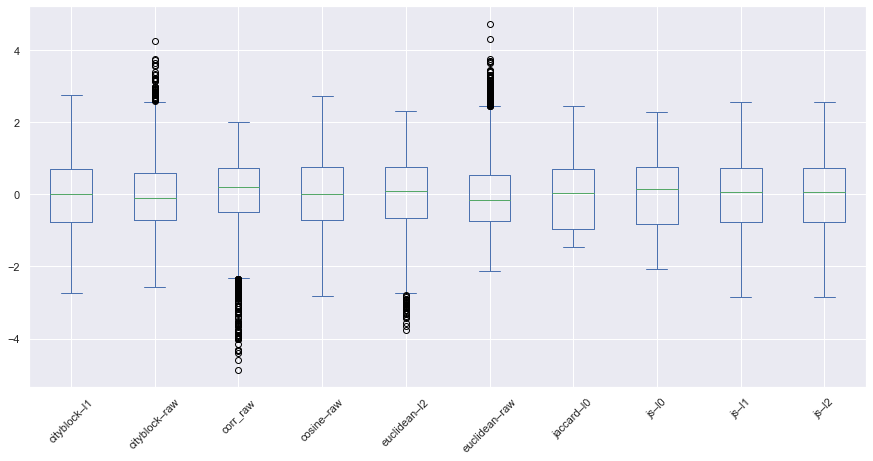

In [110]:
ZPAIRS.T.sort_index().T.plot.box(rot = 45, figsize = (15,7));

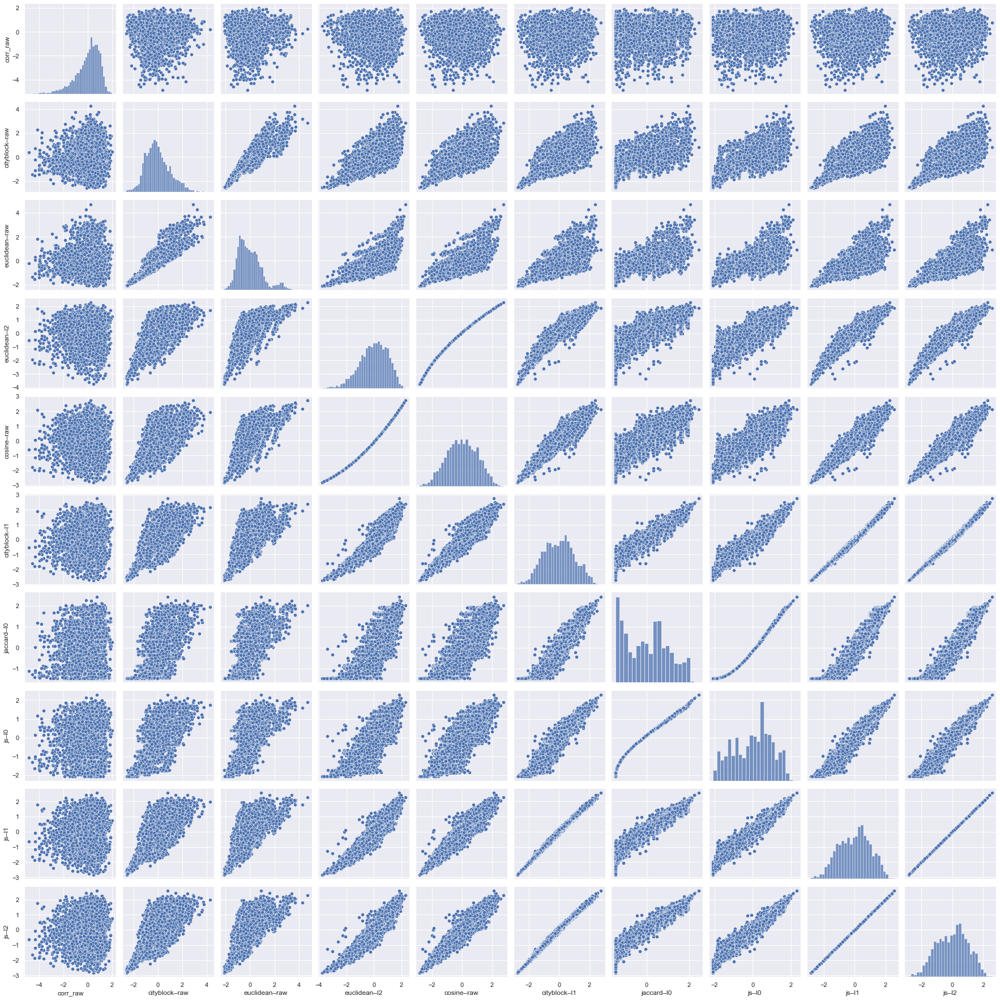

In [111]:
sns.pairplot(ZPAIRS);

### **K-Means**

**[Alogirthm Overview](https://en.wikipedia.org/wiki/K-means_clustering)**
* Goal: partition n observations of d-dimenstional real vectors so as to minimize the within-cluster sum of squares (WCSS), or variance
* Steps
    * Given an initial set of k means
    * Assignment setep: assign each observation to cluster with the nearest mean (centroid: multivariate mean in Euclidean space) based on Euclidean distance
        * Euclidean distance: $\sqrt{\sum_{i=1}^{n}(x_i - y_i)^2}$
        * Important to scale features to prevent those on larger scales from dominating
    * Update step: recalculate the means (centroids) for observations assigned to each cluster
    * Converged when assignemnts no longer change

In [112]:
n_clusters = 4

In [113]:
# instantiate KMeans model
km = KMeans(n_clusters, random_state = 314)

# compute cluster centers and predict cluster index for each sample using raw and normalized feature vectors
book_DOC['y_raw'] = km.fit_predict(mean_TFIDF_sigs)
book_DOC['y_L0'] = km.fit_predict(L0)
book_DOC['y_L1'] = km.fit_predict(L1)
book_DOC['y_L2'] = km.fit_predict(L2)

In [114]:
book_DOC.iloc[:,1:].sort_values('label').style.background_gradient(cmap = 'RdBu')

,title,label,y_raw,y_L0,y_L1,y_L2
book_id,,,,,,
1023,bleak house,dickens 1023: bleak house,0,1,0,3
1289,three ghost stories,dickens 1289: three ghost stories,1,1,0,3
1394,the holly tree,dickens 1394: the holly tree,1,0,0,3
1400,great expectations,dickens 1400: great expectations,0,1,0,3
1406,the perils of certain english prisoners,dickens 1406: the perils of certain english prisoners,1,0,0,2
1407,a message from the sea,dickens 1407: a message from the sea,0,0,0,3
1413,tom tiddlers ground,dickens 1413: tom tiddlers ground,0,3,0,3
1414,somebodys luggage,dickens 1414: somebodys luggage,1,0,0,3
1415,doctor marigold,dickens 1415: doctor marigold,0,2,0,1


## **M07: Features and Components**

In [115]:
chap_DOC = pd.DataFrame(index = TFIDF.index)

chap_DOC = chap_DOC.join(LIB['author'], on = 'book_id')

chap_DOC['label'] = chap_DOC.apply(lambda x: "{}-{}-{}".format(x.name[0], x.author, x.name[1]), 1)

chap_DOC['mean_tfidf'] = TFIDF.mean(1)

chap_DOC['n_tokens'] = BOW.groupby(OHCO[:2]).n.sum().astype('int')

In [116]:
chap_DOC = chap_DOC.join(LIB['title'], how = 'right')

chap_DOC['title_label'] = chap_DOC.apply(lambda x: "{}-{}".format(x.label, x.title.replace(' ', '-')), 1)

### **Manual PCA with 1000 most significant terms, `TFIDF_sigs` (excluding proper nouns)**

In [117]:
LOADINGS, DCM, COMPINF = get_pca(TFIDF_sigs, norm_docs = True, center_by_mean = True, center_by_variance = True)

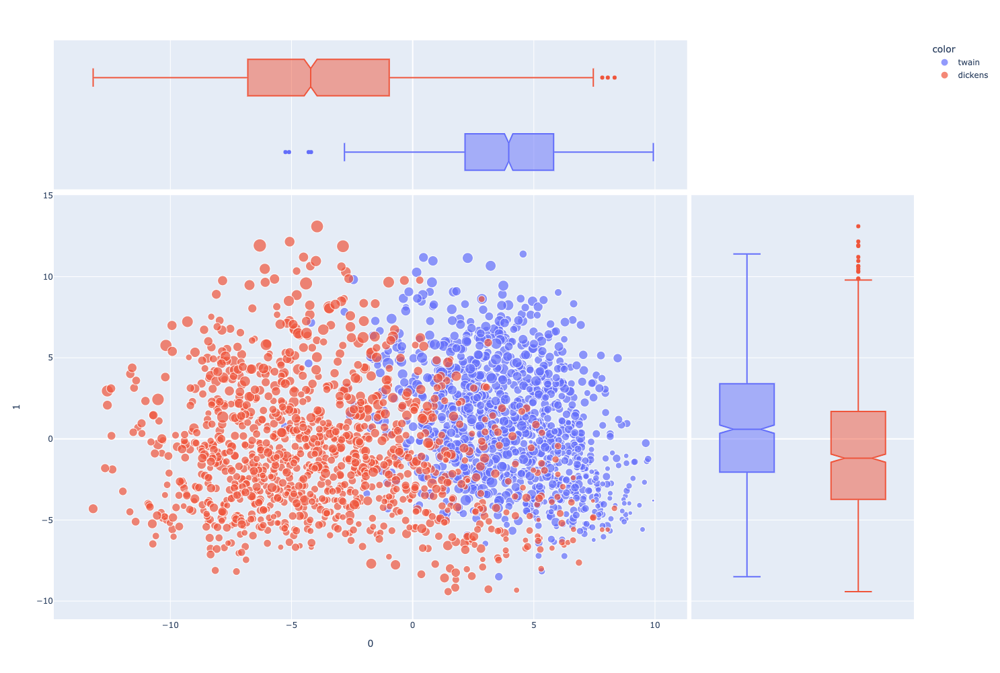

In [118]:
px.scatter(DCM, 0, 1, color=chap_DOC.author, 
           size=np.abs(chap_DOC.mean_tfidf), hover_name=chap_DOC.title_label,
           marginal_x='box', marginal_y='box', height=1000)

In [119]:
X = LOADINGS.join(SIGS, how='inner').reset_index()

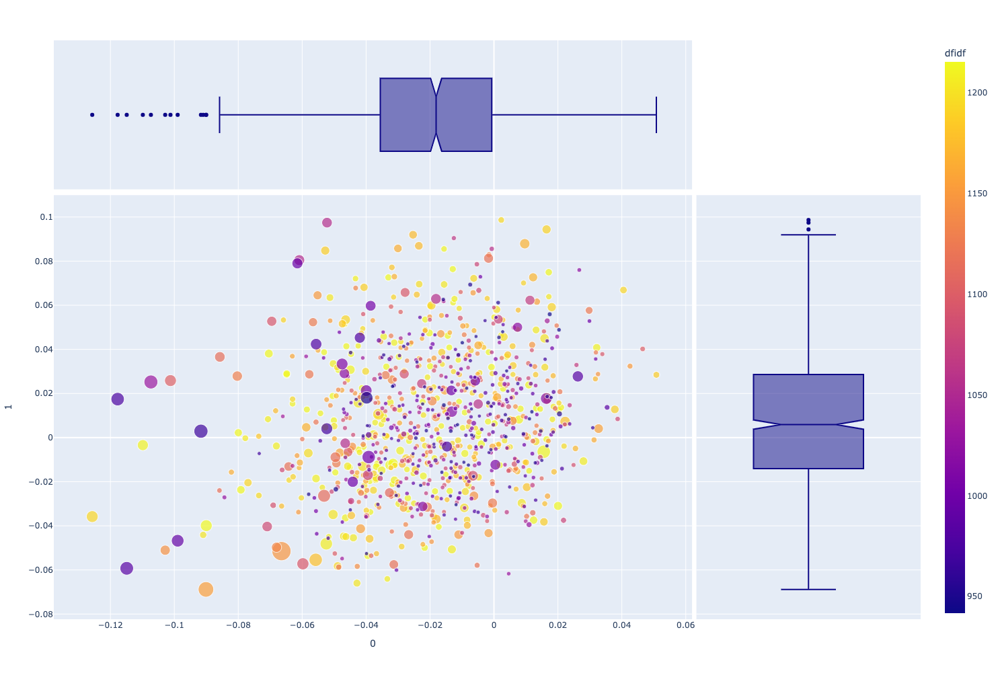

In [120]:
px.scatter(X, 0, 1, size=X.n, color=X.dfidf, 
           hover_name='term_str', hover_data=['max_pos'], 
           marginal_x='box', marginal_y='box', 
           height=1000, width=1000)

In [121]:
COMPINF

,pos,neg,eig_val,exp_var
pc_id,,,,
0,land big thirty miles later,returned looking quite cried door,26.167101,0.253370
1,sun stood feet ground sky,dear subject occasion address reference,14.957083,0.144826
2,large public high city houses,aint thats didnt wouldnt hes,12.734003,0.123300
3,heart knew matter tried able,gentleman round appearance street coat,11.830529,0.114552
4,pretty didnt wouldnt thats getting,heart loved tears voice lips,9.900917,0.095868
5,love bright flowers beautiful leaves,followed replied began force sent,6.919524,0.067000
6,called soon taken money sent,oh exclaimed countenance inquired deep,5.869772,0.056836
7,does power takes says goes,letter morning wrote letters write,5.241137,0.050749
8,married died children everybody ladies,letter letters wrote write written,5.016770,0.048576


### **Prince PCA with entire TFIDF**

In [122]:
pca = PCA(
    n_components=6,
    n_iter=3,
    rescale_with_mean=False,
    rescale_with_std=False,
    copy=True,
    check_input=True,
    engine='auto',
    random_state=42
)

In [123]:
pca = pca.fit(TFIDF)

In [124]:
dcm = pca.transform(TFIDF)

In [125]:
dcm

0         1         2         3         4         5
book_id chap_id                                                            
70      1        0.065679 -0.049468 -0.039947 -0.043511  0.071587  0.138689
        2        0.082694 -0.023188 -0.007906 -0.011944  0.007288  0.009795
        3        0.296299 -0.055532 -0.051364 -0.062294  0.025548  0.095364
        4        0.226935 -0.095348 -0.038324 -0.034792  0.053698  0.042130
        5        0.259896 -0.135070 -0.061179  0.039852  0.034269  0.024191
...                   ...       ...       ...       ...       ...       ...
62739   2        0.331254 -0.150715 -0.079305  0.017026  0.037009 -0.002100
        3        0.166589 -0.090888 -0.046341  0.033137  0.019530  0.039714
        4        0.156358 -0.086624 -0.073764  0.045169  0.038146  0.035988
        5        0.146723  0.036413 -0.054062  0.052735  0.016596  0.044038
        6        0.109309  0.020163 -0.053274  0.058753  0.010248  0.063363

[2290 rows x 6 columns]

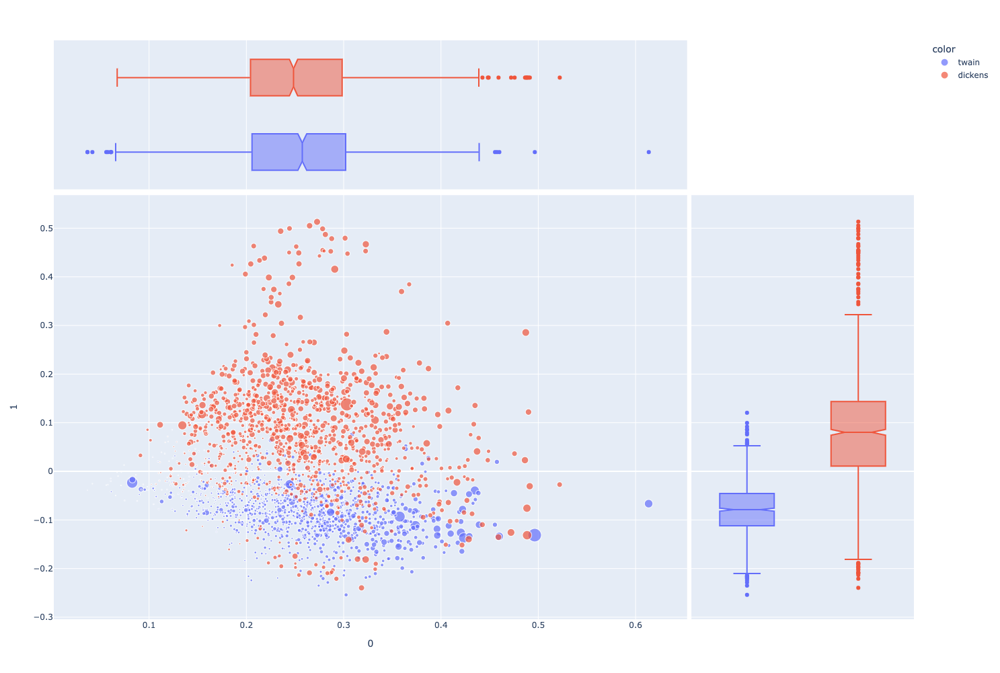

In [126]:
px.scatter(dcm, 0, 1, 
           color=chap_DOC.author,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.title_label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

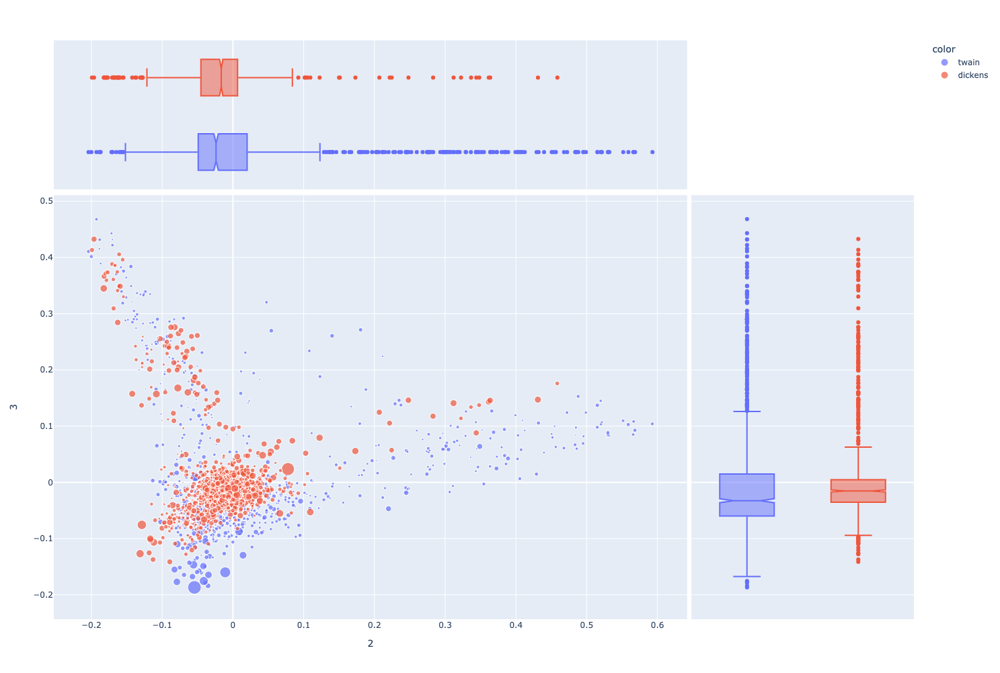

In [127]:
px.scatter(dcm, 2, 3, 
           color=chap_DOC.author,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.title_label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

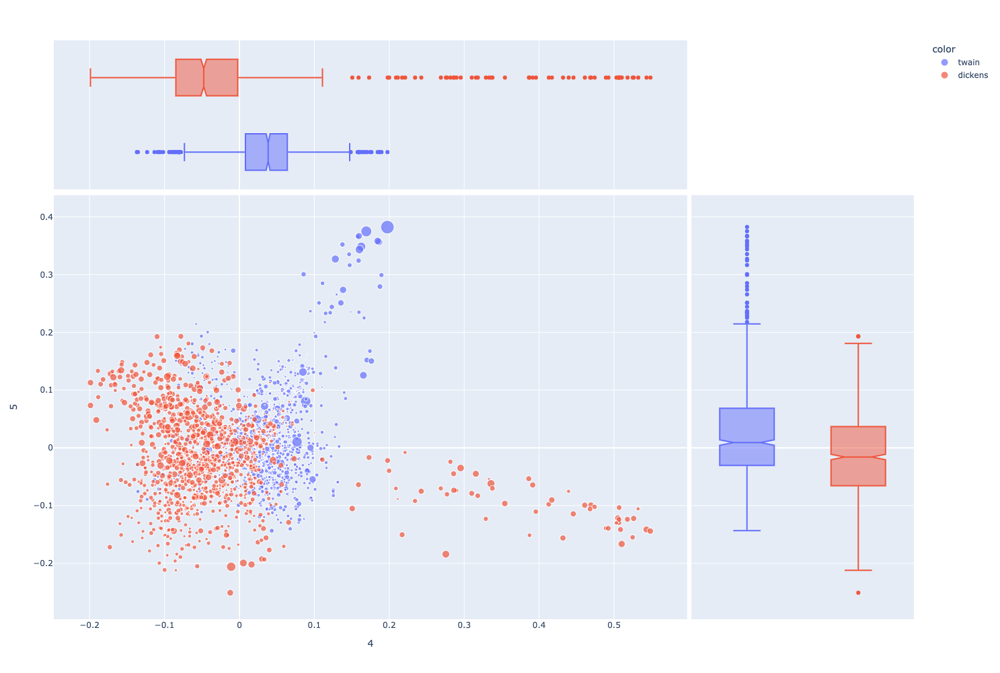

In [128]:
px.scatter(dcm, 4, 5, 
           color=chap_DOC.author,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.title_label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

In [129]:
LCM = DCM.groupby('book_id').mean().sort_index()
LCM.index = LIB.loc[list(LCM.index)].label

In [130]:
LCM.sort_values(0, ascending=False).style.background_gradient(cmap='GnBu', high=.5, axis=1)

pc_id,0,1,2,3,4,5,6,7,8,9
label,,,,,,,,,,
twain 3188: mark twain speeches,6.626867,-3.557832,-1.188361,-0.945597,-1.607546,0.668229,0.248522,-0.350837,-0.968040,0.003742
twain 91: tom sawyer abroad,6.163374,3.002346,-8.635602,0.256668,4.578791,2.092381,1.643109,2.328907,1.337506,-3.666191
twain 1086: a horses tale,5.838930,-0.503784,-3.681665,-0.005267,-1.367326,2.208763,-1.173451,0.140394,1.298938,-0.184841
twain 76: the adventures of huckleberry finn,5.831029,2.429172,-9.535481,-0.178109,4.072546,1.936619,3.148480,1.162079,1.640122,-1.748173
twain 3191: goldsmiths friend abroad again,5.665696,-0.025709,-1.718715,-0.565025,-1.758280,-2.525068,1.250637,0.175760,0.214855,1.162173
twain 3192: the curious republic of gondour and other whimsical sketches,5.465101,-2.460831,0.801128,-0.623560,-1.222478,-1.107560,0.211913,0.484775,0.258641,-0.195348
twain 93: tom sawyer detective,5.422892,1.500789,-10.387069,1.091529,3.554791,1.685851,1.991694,1.013576,3.028808,-2.712922
dickens 35536: the poems and verses of charles dickens,5.273149,-1.649346,0.103911,-2.464240,-3.654964,2.795077,-0.257304,-0.825513,-0.813431,0.416608
twain 245: life on the mississippi,5.237720,2.028317,0.296643,-0.348339,1.097013,-0.698508,0.016073,0.196954,-0.812127,-1.157381


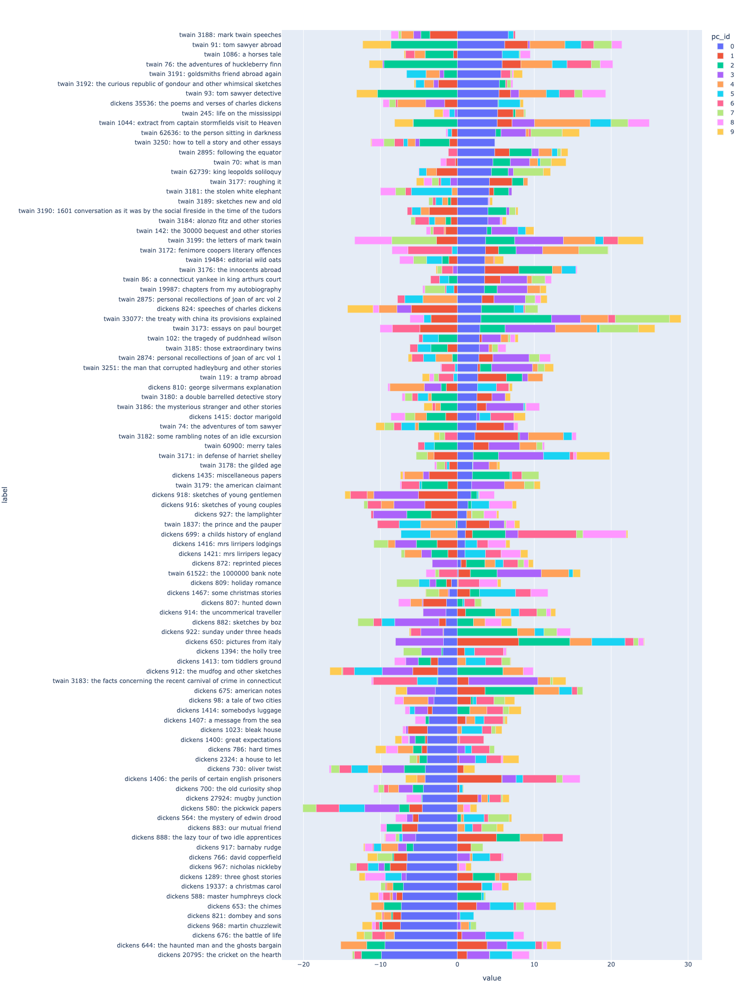

In [131]:
px.bar(LCM.sort_values(0), height=2000, orientation='h', barmode='relative')

### **Prince PCA with 1000 most significant terms, `TFIDF_sigs` (excluding proper nouns)**

In [132]:
pca_sigs = pca.fit(TFIDF_sigs)

In [133]:
dcm_sigs = pca_sigs.transform(TFIDF_sigs)

In [134]:
dcm_sigs

0         1         2         3         4         5
book_id chap_id                                                            
70      1        0.026057  0.007490 -0.014392 -0.005478  0.001106  0.009554
        2        0.053652  0.006198 -0.003991 -0.023260 -0.001496  0.004126
        3        0.185298  0.020615 -0.044449 -0.074507 -0.033730 -0.012305
        4        0.142195  0.044603 -0.027066 -0.038997  0.020027  0.016052
        5        0.166398  0.057782 -0.051987 -0.004399  0.016037  0.002321
...                   ...       ...       ...       ...       ...       ...
62739   2        0.205180  0.037503 -0.052001 -0.026238 -0.011311  0.003950
        3        0.086693  0.022272 -0.021170 -0.026683  0.015973  0.005813
        4        0.080406  0.022880 -0.021682 -0.018395  0.021709 -0.003432
        5        0.065854 -0.007160 -0.013794 -0.031168  0.019115 -0.005560
        6        0.033229 -0.001601 -0.013526 -0.013082  0.012172  0.000780

[2290 rows x 6 columns]

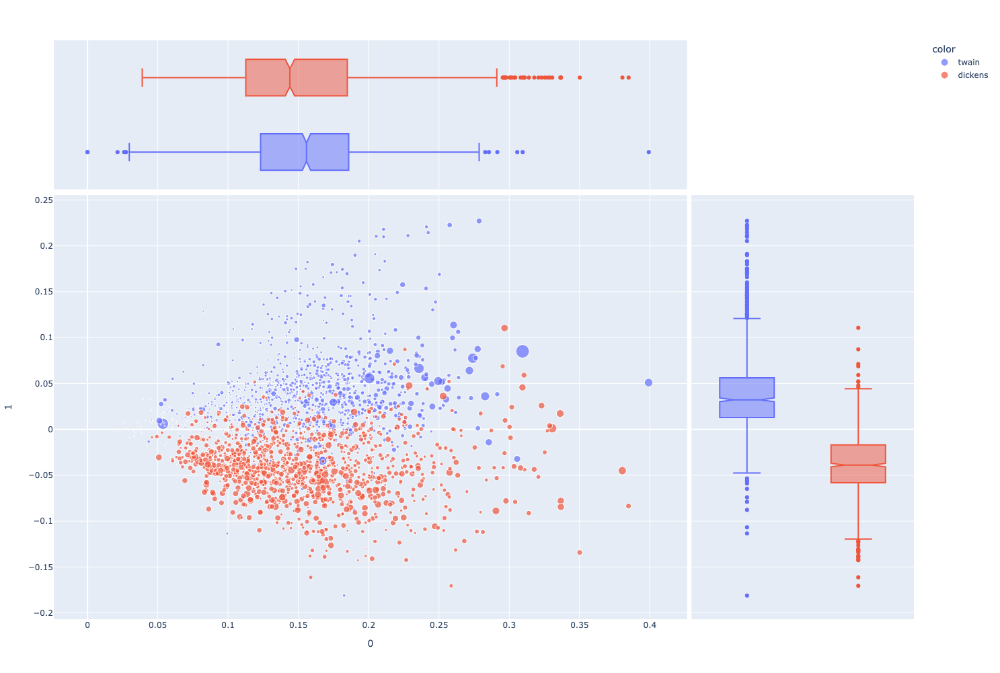

In [135]:
px.scatter(dcm_sigs, 0, 1, 
           color=chap_DOC.author,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.title_label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

In [136]:
VOCAB

,term_rank,n,n_chars,n_tokens,tfidf_mean,df,dfidf,term_rank2,zipf_k,zipf_k2
term_str,,,,,,,,,,
said,1,38907,4,1,0.062423,2063,310.695592,1,38907,38907
mr,2,32405,2,1,0.052473,1456,951.259025,2,64810,64810
time,3,15969,4,1,0.031210,2169,169.870756,3,47907,47907
little,4,15935,6,1,0.029052,2062,311.987334,4,63740,63740
man,5,15230,3,1,0.030357,2004,385.700040,5,76150,76150
...,...,...,...,...,...,...,...,...,...,...
wait little,14996,32,11,2,0.000381,29,182.791376,1265,479872,40480
mistrusted,14997,32,10,1,0.000256,30,187.627239,1265,479904,40480
miss charity,14998,32,12,2,0.000137,12,90.914033,1265,479936,40480


#### **Sources**

* How to display specific lines of a file in linux command line: https://linuxhandbook.com/display-specific-lines/
* Using grep to search for specific lines in files: https://phoenixnap.com/kb/grep-command-linux-unix-examples#:~:text=Grep%20is%20a%20Linux%20%2F%20Unix,searching%20through%20large%20log%20files
* Use grep to report back only line numbers (rather than line number and text searched for) with pipe | cut -f1 -d: : https://stackoverflow.com/questions/6958841/use-grep-to-report-back-only-line-numbers
* How to count lines in a document with wc -l file.txt: https://stackoverflow.com/questions/3137094/how-to-count-lines-in-a-document
* Get line number while using grep with -n flag: https://stackoverflow.com/questions/3213748/get-line-number-while-using-grep
* Display only the n'th match of grep: https://stackoverflow.com/questions/15135430/display-only-the-nth-match-of-grep
* How to split a file at a line number: https://stackoverflow.com/questions/3066948/how-to-file-split-at-a-line-number
* Delete specific line number(s) from a text file using sed: https://stackoverflow.com/questions/2112469/delete-specific-line-numbers-from-a-text-file-using-sed
* Using sed with an integer variable $\rightarrow$ requires dollar signs and curly braces around variable name to expand inside double quotes (`${var}`): https://unix.stackexchange.com/questions/462857/using-sed-with-an-integer-variable
* Bash - using sed with a variable line number, and variables in the line replacement: https://stackoverflow.com/questions/26319607/bash-using-sed-with-a-variable-line-number-and-variables-in-the-line-replaceme
* Copy files and directories in Linux: https://phoenixnap.com/kb/how-to-copy-files-directories-linux
* `pandas.DataFrame.duplicated(subset = None, keep = 'first')` to return boolean Series denoting duplicate rows: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.duplicated.html
* `pandas.DataFrame.drop_duplicates(subset = None, keep = 'first')` to drop duplicate values: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.drop_duplicates.html
* Solving error "'utf8' code can't decode byte 0xe9 in position x: invalid continuation byte" with `encoding='latin-1'`: https://stackoverflow.com/questions/5552555/unicodedecodeerror-invalid-continuation-byte
* String `.join()` method (`separator.join()`): https://www.programiz.com/python-programming/methods/string/join
* Convert a string to a regex pattern: https://stackoverflow.com/questions/58351975/convert-string-to-regex-pattern
* Regex that does not match anything (for works that do not have chapters): https://stackoverflow.com/questions/940822/regular-expression-syntax-for-match-nothing
* Using `(?:)` with capture groups to solve UserWarning: This pattern has match groups. To actually get the groups, use str.extract: https://stackoverflow.com/questions/39901550/python-userwarning-this-pattern-has-match-groups-to-actually-get-the-groups
* Markdown table generator: https://www.tablesgenerator.com/markdown_tables
* How to find a HTML tag that contains certain text using BeautifulSoup: https://www.geeksforgeeks.org/how-to-find-a-html-tag-that-contains-certain-text-using-beautifulsoup/
* List comprehension replace if condition else: https://stackoverflow.com/questions/32457352/list-comprehension-replace-if-condition-else
* How to insert a character into a string at an index in Python: https://www.adamsmith.haus/python/answers/how-to-insert-a-character-into-a-string-at-an-index-in-python
* Using regex in an `if` statement with `re.match(regex, string)`: https://stackoverflow.com/questions/14225608/python-how-to-use-regex-in-an-if-statement
* Create pandas column from a dictionary of lists (reverse values and keys): https://stackoverflow.com/questions/48724285/create-pandas-column-from-dictionary-of-lists
* Using `pd.cut()` with label names: https://pandas.pydata.org/docs/reference/api/pandas.cut.html
* Dictionary comprehensions: https://www.datacamp.com/community/tutorials/python-dictionary-comprehension
* Getting all combinations of values in a list with `itertools.combinations`: https://stackoverflow.com/questions/464864/how-to-get-all-possible-combinations-of-a-list-s-elements
* Filtering a dataframe with a multi-index with lists of tuples (with \[(first_index_val, second_index_val), (first_index_val, second_index_val), ...\]: https://pandas.pydata.org/pandas-docs/stable/user_guide/advanced.html#advanced-indexing-with-hierarchical-index
* Return max value from pandas dataframe as a whole: https://stackoverflow.com/questions/24571005/return-max-value-from-pandas-dataframe-as-a-whole-not-based-on-column-or-rows
* `pandas.DataFrame.idxmax()` to return index of first occurrence of max over requested axis: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.any.html
* String method `.title()` to capitalize all words: https://thispointer.com/python-capitalize-the-first-letter-of-each-word-in-a-string/#:~:text=Use%20title()%20to%20capitalize,of%20word%20to%20lower%20case.
* Move column to new position in df with `df.pop()` and `df.insert()`: https://www.geeksforgeeks.org/how-to-move-a-column-to-first-position-in-pandas-dataframe/#:~:text=The%20basic%20idea%20to%20move,pop()%20and%20insert().
* K-means algorithm: https://en.wikipedia.org/wiki/K-means_clustering
* Select all Rows with NaN Values in Pandas DataFrame with `df[df.isnull().any(axis=1)]`: https://datatofish.com/rows-with-nan-pandas-dataframe/